In [1]:
# from datasets import Dataset,DatasetDict,load_from_disk
# import pandas as pd
# dataset=pd.read_excel('data.xlsx')
# dataset=Dataset.from_pandas(dataset)
#
#
# data_train=dataset.filter(lambda x:x['train_set']==1)
# data_valid=dataset.filter(lambda x:x['valid_set']==1)
# data_test=dataset.filter(lambda x:x['test_set']==1)
#
# dataset_dict=DatasetDict()
# dataset_dict['train']=data_train
# dataset_dict['valid']=data_valid
# dataset_dict['test']=data_test
# dataset_dict.save_to_disk('dataset')
# dataset_dict=load_from_disk('dataset')

In [2]:
# dataset_dict=dataset.train_test_split(test_size=0.1)
#
# data=dataset_dict['test'].train_test_split(test_size=0.5)
#
# dataset_dict['valid']=data['train']
# dataset_dict['test']=data['test']

In [3]:
from datasets import load_dataset,load_from_disk
# \t is the tab character in Python
dataset_dict = load_from_disk('dataset_aug')
dataset_dict=dataset_dict.select_columns(['smi','logkOH•'])

In [5]:
import torch
from transformers import GPT2Tokenizer, GPT2Model, GPT2Config, Trainer, TrainingArguments,GPT2DoubleHeadsModel,GPT2PreTrainedModel,GPT2ForSequenceClassification
from datasets import load_dataset

# 定义标记器和模型配置
tokenizer = GPT2Tokenizer.from_pretrained(r"D:\system\桌面\lcm-code\tokenizers_lcm\tokenizer_gpt100.json")
tokenizer.pad_token = tokenizer.eos_token
tokenizer.pad_token

'<|endoftext|>'

In [6]:
# from torch import nn
# from torch.nn.utils import prune
# class GPT2LinearOutput(nn.Module):
#     def __init__(self,n_block,drop,purn):
#         super(GPT2LinearOutput, self).__init__()
#         self.config=GPT2Config.from_pretrained('D:\system\桌面\lcm-code\pre_training\chem_gpt100')
#         self.config.pad_token_id=tokenizer.pad_token_id
#         self.config.num_attention_heads=4
#         self.config.num_hidden_layers=n_block
#         self.config.hidden_size=512
#         self.gpt2 = GPT2DoubleHeadsModel(self.config)
#         self.linear = nn.Linear(self.gpt2.config.vocab_size, 1)  # 输出维度为1的线性层
#         for name, module in self.gpt2.named_modules():
#             if isinstance(module, (nn.Dropout, nn.Dropout2d, nn.Dropout3d)):
#                 module.p = drop
#         for name, module in self.gpt2.named_modules():
#             if isinstance(module, torch.nn.Linear):
#                 prune.l1_unstructured(module, name='weight', amount=purn)
#
#     def forward(self, input_ids, attention_mask):
#         outputs = self.gpt2(input_ids=input_ids,attention_mask=attention_mask)
#         last_hidden_states = outputs.logits
#         linear_output = self.linear(last_hidden_states)  # 只使用最后一个位置的隐藏状态
#         return linear_output

In [7]:
from torch import nn
from torch.nn.utils import prune

class GPT2LinearOutput(nn.Module):
    def __init__(self,n_block,drop,purn):
        super(GPT2LinearOutput, self).__init__()
        self.config=GPT2Config.from_pretrained('D:\system\桌面\lcm-code\pre_training\chem_gpt100')
        self.config.pad_token_id=tokenizer.pad_token_id
        self.config.num_attention_heads=4
        self.config.num_hidden_layers=n_block
        self.config.hidden_size=512
        self.gpt2 = GPT2Model(self.config)  #  使用预训练的GPT2模型
        self.linear = nn.Linear(self.config.hidden_size, 1)  # 输出维度为1的线性层
        for name, module in self.gpt2.named_modules():
            if isinstance(module, (nn.Dropout, nn.Dropout2d, nn.Dropout3d)):
                module.p = drop
        for name, module in self.gpt2.named_modules():
            if isinstance(module, torch.nn.Linear):
                prune.l1_unstructured(module, name='weight', amount=purn)

    def forward(self, input_ids, attention_mask):
        outputs = self.gpt2(input_ids=input_ids,attention_mask=attention_mask)
        last_hidden_states = outputs.last_hidden_state
        linear_output = self.linear(last_hidden_states)  # 只使用最后一个位置的隐藏状态
        return linear_output

In [8]:
tokenized_dataset = dataset_dict.map(
    lambda element: tokenizer(element['smi']),batched=True
)
def returnlength(example):
    return  {'length':len(example['input_ids'])-1}

tokenized_dataset=tokenized_dataset.map(returnlength)
tokenized_dataset=tokenized_dataset.select_columns(['input_ids','attention_mask','logkOH•','length'])
tokenized_dataset


DatasetDict({
    train: Dataset({
        features: ['input_ids', 'attention_mask', 'logkOH•', 'length'],
        num_rows: 2222
    })
    valid: Dataset({
        features: ['input_ids', 'attention_mask', 'logkOH•', 'length'],
        num_rows: 138
    })
    test: Dataset({
        features: ['input_ids', 'attention_mask', 'logkOH•', 'length'],
        num_rows: 138
    })
})

In [9]:
# import torch



In [10]:
import torch
# from torch.utils.data import DataLoader, Dataset
# model=GPT2LinearOutput()


In [11]:
from transformers import DataCollatorWithPadding
from torch.utils.data import DataLoader, Dataset
data_collator = DataCollatorWithPadding(tokenizer=tokenizer)
tokenized_dataset.set_format("torch")



In [12]:
from torch.optim import AdamW
import torch.nn as nn
from transformers import get_scheduler

gradient_accumulation_steps=20

criterion = nn.MSELoss()

# num_train_epochs = 500
# num_update_steps_per_epoch = len(train_dataloader)
# num_training_steps = num_train_epochs * num_update_steps_per_epoch/gradient_accumulation_steps



In [13]:
from accelerate import Accelerator

accelerator = Accelerator()

# model.load_state_dict(torch.load('best_val0.model'))


In [14]:
import torch
def caculate(loader,model):
    losses=[]
    model.eval()
    for batch in loader:
        with torch.no_grad():
            labels = batch['logkOH•']
            batch['input_ids']=batch['input_ids'].to(torch.int64)
            logits = model(batch['input_ids'],batch['attention_mask']).squeeze()[torch.arange(0,len(batch['input_ids'])),batch['length']]
            loss = criterion(logits, labels)
            losses.append(loss.unsqueeze(dim=0))
    torch.cuda.empty_cache()
    return torch.sqrt(torch.mean(torch.cat(losses,dim=0))).cpu().numpy()

In [15]:
import numpy as np
from sklearn.metrics import r2_score
def caculater2(loader,model):
    y_true=[]
    y_pre=[]
    model.eval()
    for batch in loader:
        with torch.no_grad():
            labels = batch['logkOH•']
            batch['input_ids']=batch['input_ids'].to(torch.int64)
            logits = model(batch['input_ids'],batch['attention_mask']).squeeze()[torch.arange(0,len(batch['input_ids'])),batch['length']]
            y_true.extend(labels.cpu().numpy())
            y_pre.extend(logits.cpu().numpy())
    return r2_score(y_true,y_pre)

In [0]:

from torch.cuda.amp import autocast
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
import optuna



plt.style.use('ggplot')
plt.rcParams['font.family'] = 'Times New Roman'

def objective(trial):


    train_losses=[]
    eval_losses=[]
    eval_r2s=[]
    train_r2s=[]

    train_dataloader = DataLoader(tokenized_dataset["train"], batch_size=64, shuffle=True,collate_fn=data_collator)
    eval_dataloader = DataLoader(tokenized_dataset["valid"], batch_size=20,collate_fn=data_collator)
    train_dataloader, eval_dataloader = accelerator.prepare(
        train_dataloader, eval_dataloader
    )

    num_blocks=trial.suggest_int("num_blocks", 2,8)
    dropout=trial.suggest_float("dropout", 0.1, 0.3)
    purn=trial.suggest_float("purns",0.1,0.3)
    model =GPT2LinearOutput(num_blocks,dropout,purn)

    lr = trial.suggest_float("lr", 1e-5, 5e-3, log=True)
    optimizer = AdamW(model.parameters(), lr=lr)

    num_train_epochs=100
    num_update_steps_per_epoch = len(train_dataloader)
    num_training_steps = num_train_epochs * num_update_steps_per_epoch/gradient_accumulation_steps

    lr_scheduler = get_scheduler(
    name="cosine",
    optimizer=optimizer,
    num_warmup_steps=num_training_steps//4,
    num_training_steps=num_training_steps)

    model,optimizer=accelerator.prepare(model,optimizer)


    completed_steps = 1


    # best_losses=[]
    # best_models=[]

    best_val = float("inf")
    for epoch in tqdm(range(num_train_epochs),total=num_train_epochs):
        scaler = torch.cuda.amp.GradScaler()
        model.train()
        for step,batch in enumerate(train_dataloader):
            with autocast():

                labels = batch['logkOH•']
                batch['input_ids']=batch['input_ids'].to(torch.int64)

                logits = model(batch['input_ids'],batch['attention_mask']).squeeze()[torch.arange(0,len(batch['input_ids'])),batch['length']]

                loss = criterion(logits, labels)

                # loss=loss/gradient_accumulation_steps

                scaler.scale(loss).backward()



                # accelerator.clip_grad_norm_(model.parameters(), 1.0)
                scaler.step(optimizer)
                lr_scheduler.step()
                optimizer.zero_grad()
                completed_steps += 1
                scaler.update()
                torch.cuda.empty_cache()


        eval_loss=caculate(eval_dataloader,model)
        train_loss=caculate(train_dataloader,model)


        eval_losses.append(eval_loss)
        train_losses.append(train_loss)


        eval_r2=caculater2(eval_dataloader,model)
        train_r2=caculater2(train_dataloader,model)
        eval_r2s.append(eval_r2)
        train_r2s.append(train_r2)

        tqdm.write(f'train_loss{train_loss} eval_loss:{eval_loss} trainr2 {train_r2} evalr2 {eval_r2}')

        torch.cuda.empty_cache()
        del scaler
            # 保存最佳模型和对应的验证集损失
        # if len(best_models) < 3 or eval_loss < min(best_losses):
        #     best_models.append(model.state_dict())
        #     best_losses.append(eval_loss)
        #
        # # 如果保存的模型数量超过了5个，则删除验证集损失最大的模型
        # if len(best_models) > 3:
        #     max_loss_idx = best_losses.index(max(best_losses))
        #     del best_models[max_loss_idx]
        #     del best_losses[max_loss_idx]

        # if eval_loss < best_val:
        #     torch.save(model.state_dict(), 'best_val.model')
        #     best_val = eval_loss


    fig, ax1 = plt.subplots(figsize=(10, 6))
    # 绘制 accuracy
    ax1.plot(range(num_train_epochs), train_r2s, label='Train r2', marker='o', color='blue', linestyle='--')
    ax1.plot(range(num_train_epochs), eval_r2s, label='Eval r2', marker='x',color='blue', linestyle='--')
    ax1.fill_between(range(num_train_epochs), train_r2s, eval_r2s, color='lightblue', alpha=0.1, zorder=2)
    ax1.set_xlabel('Epochs', fontsize=10)
    ax1.set_ylabel('R2', fontsize=10)
    ax1.set_title('Train and Eval Accuracy Over Epochs', fontsize=16)
    ax1.legend(loc='upper left', fontsize=10)

    # 创建第二个 y 轴并绘制 loss
    ax2 = ax1.twinx()
    ax2.plot(range(num_train_epochs), train_losses, label='Train Loss', color='red', linestyle='--', marker='o')
    ax2.plot(range(num_train_epochs), eval_losses, label='Eval Loss', color='red', linestyle='--', marker='x')
    ax2.fill_between(range(num_train_epochs), train_losses, eval_losses, alpha=0.1,color='lightgreen')
    ax2.set_ylabel('Loss', fontsize=10)
    ax2.legend(loc='lower right', fontsize=10)

    plt.grid(True)
    plt.tight_layout()
    plt.gcf().set_dpi(300)
    plt.show()

    del model
    del optimizer
    del train_dataloader
    del eval_dataloader

    if trial.should_prune():
        raise optuna.exceptions.TrialPruned()
    return min(eval_losses)

In [0]:
import pickle
from optuna.trial import TrialState

if __name__ == "__main__":
    study = optuna.create_study(direction="minimize")
    study.optimize(objective,n_trials=50)

    pruned_trials = study.get_trials(deepcopy=False, states=[TrialState.PRUNED])
    complete_trials = study.get_trials(deepcopy=False, states=[TrialState.COMPLETE])
    with open('example-study111.pkl', 'wb') as f:
        pickle.dump(study, f)
    print("Study statistics: ")
    print("  Number of finished trials: ", len(study.trials))
    print("  Number of pruned trials: ", len(pruned_trials))
    print("  Number of complete trials: ", len(complete_trials))

    print("Best trial:")
    trial = study.best_trial

    print("  Value: ", trial.value)

    print("  Params: ")
    for key, value in trial.params.items():
        print("    {}: {}".format(key, value))

[I 2024-05-05 18:11:16,397] A new study created in memory with name: no-name-748ca213-4e67-4439-9480-b72c88c2da2e


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.6347983479499817 eval_loss:0.6820038557052612 trainr2 -0.23365656579200955 evalr2 -0.1588208997697591
train_loss0.6973050832748413 eval_loss:0.7020249366760254 trainr2 -0.4798075316138266 evalr2 -0.23365777793868148
train_loss0.5562565922737122 eval_loss:0.5933827757835388 trainr2 0.05646292301883582 evalr2 0.12288182727733643
train_loss0.4934014678001404 eval_loss:0.5524337291717529 trainr2 0.2585371870172679 evalr2 0.24070148288530524
train_loss0.49977344274520874 eval_loss:0.5652080178260803 trainr2 0.23862925930533208 evalr2 0.20432105590386884
train_loss0.49744030833244324 eval_loss:0.5652539730072021 trainr2 0.24714821846022117 evalr2 0.20404001667722915
train_loss0.506217896938324 eval_loss:0.6150917410850525 trainr2 0.21782947654204077 evalr2 0.05270403393816947
train_loss0.465421587228775 eval_loss:0.5355981588363647 trainr2 0.33736621811859946 evalr2 0.2829152314654255
train_loss0.40221214294433594 eval_loss:0.5187914967536926 trainr2 0.5056135900226699 evalr2 0.3

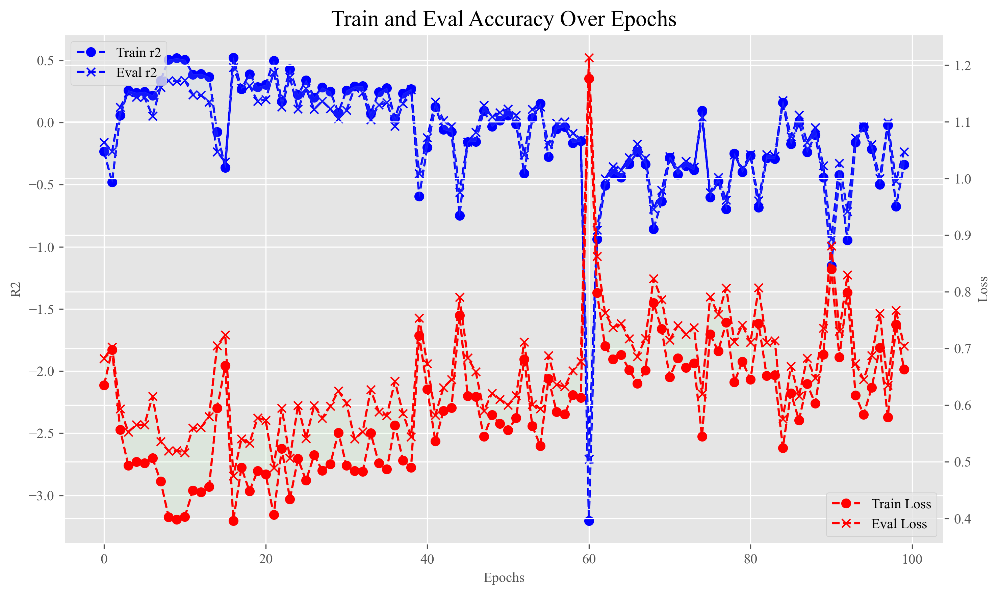

[I 2024-05-05 18:16:23,042] Trial 0 finished with value: 0.47462546825408936 and parameters: {'num_blocks': 3, 'dropout': 0.20899390918258504, 'purns': 0.20768085305927847, 'lr': 0.0023354585869942985}. Best is trial 0 with value: 0.47462546825408936.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.9775297045707703 eval_loss:1.129662275314331 trainr2 -1.905614227827054 evalr2 -2.238287063400177
train_loss1.9603052139282227 eval_loss:1.931660771369934 trainr2 -10.70617811936032 evalr2 -8.479793376538236
train_loss1.9084364175796509 eval_loss:1.8903868198394775 trainr2 -10.108430771179055 evalr2 -8.074524902669634
train_loss1.8327926397323608 eval_loss:1.8166296482086182 trainr2 -9.229246303804823 evalr2 -7.3773414864389775
train_loss1.8202338218688965 eval_loss:1.8055875301361084 trainr2 -9.099970624375908 evalr2 -7.275313095689263
train_loss1.8086189031600952 eval_loss:1.7934215068817139 trainr2 -8.957968580471912 evalr2 -7.163641537215254
train_loss1.7396546602249146 eval_loss:1.7304672002792358 trainr2 -8.23132219378053 evalr2 -6.597435233489866
train_loss1.6564831733703613 eval_loss:1.6554492712020874 trainr2 -7.376995570599066 evalr2 -5.948375395658472
train_loss1.6064263582229614 eval_loss:1.6128287315368652 trainr2 -6.875555535731321 evalr2 -5.592113975830531
tr

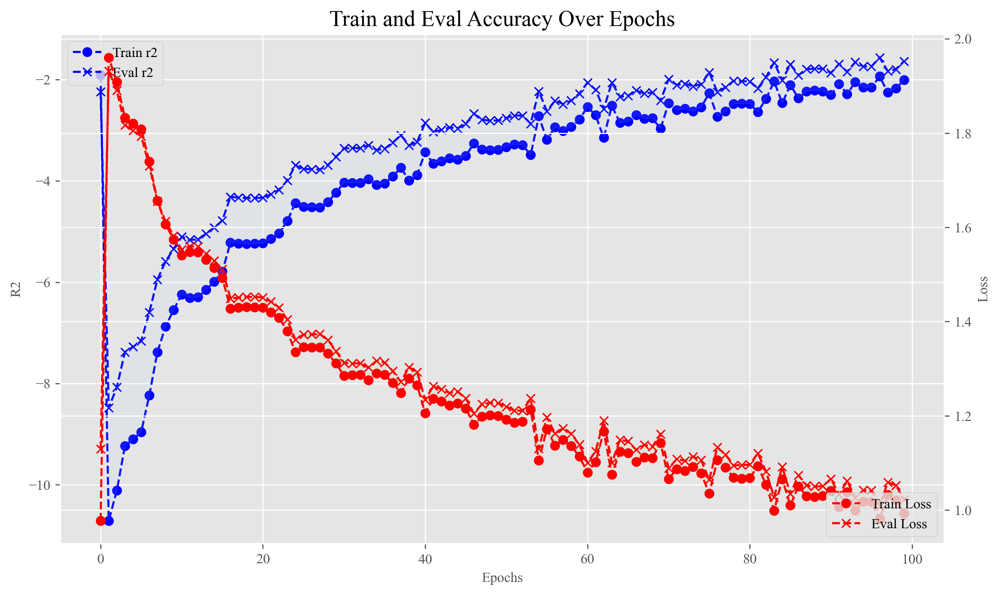

[I 2024-05-05 18:20:16,204] Trial 1 finished with value: 1.0081502199172974 and parameters: {'num_blocks': 2, 'dropout': 0.2647979924888054, 'purns': 0.2045460288059991, 'lr': 1.356003685488885e-05}. Best is trial 0 with value: 0.47462546825408936.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5546432733535767 eval_loss:0.6153181195259094 trainr2 0.05934021440877779 evalr2 0.054097313240049516
train_loss0.9340822696685791 eval_loss:0.977051854133606 trainr2 -1.6589864914542694 evalr2 -1.396685114890166
train_loss0.8282065391540527 eval_loss:0.861580491065979 trainr2 -1.09283735847047 evalr2 -0.8605009519175635
train_loss0.8300542831420898 eval_loss:0.8564059138298035 trainr2 -1.0984442165369108 evalr2 -0.8391293165568046
train_loss0.8403939008712769 eval_loss:0.8659858107566833 trainr2 -1.1537558551995968 evalr2 -0.881133387821345
train_loss0.8525053262710571 eval_loss:0.8757517337799072 trainr2 -1.210575511771658 evalr2 -0.9244580762814743
train_loss0.8793227076530457 eval_loss:0.8978782892227173 trainr2 -1.3604658968997452 evalr2 -1.025470841950642
train_loss0.7168119549751282 eval_loss:0.7317925095558167 trainr2 -0.5720562816738166 evalr2 -0.34199817832267
train_loss0.9558202624320984 eval_loss:0.9621856212615967 trainr2 -1.7879487839453825 evalr2 -1.336976946

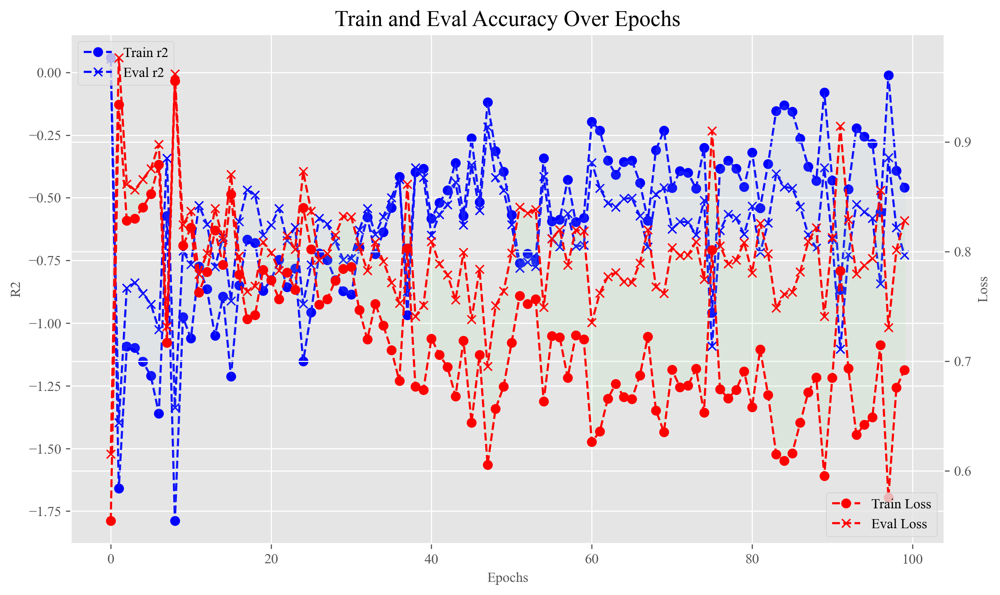

[I 2024-05-05 18:24:17,929] Trial 2 finished with value: 0.6153181195259094 and parameters: {'num_blocks': 2, 'dropout': 0.25501557405860775, 'purns': 0.26449642510481863, 'lr': 0.00019071185906711}. Best is trial 0 with value: 0.47462546825408936.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.9377070069313049 eval_loss:0.9226304292678833 trainr2 -1.686943195225211 evalr2 -1.149762286554592
train_loss0.6901381015777588 eval_loss:0.7190572023391724 trainr2 -0.4512442156152827 evalr2 -0.29721854530495695
train_loss0.7175705432891846 eval_loss:0.7411344647407532 trainr2 -0.5700347164403421 evalr2 -0.3782003826022087
train_loss0.675396740436554 eval_loss:0.6992042660713196 trainr2 -0.38973628863997867 evalr2 -0.2250028832268196
train_loss0.6681170463562012 eval_loss:0.6923624873161316 trainr2 -0.3610405987472318 evalr2 -0.20087146413604628
train_loss0.6717050671577454 eval_loss:0.6948774456977844 trainr2 -0.3728745917560312 evalr2 -0.2096908665277757
train_loss0.6503906846046448 eval_loss:0.6746279001235962 trainr2 -0.2926346343216728 evalr2 -0.13940121678578854
train_loss0.6264483332633972 eval_loss:0.6494913697242737 trainr2 -0.20146446572387355 evalr2 -0.05502923742510624
train_loss0.6131728291511536 eval_loss:0.6359290480613708 trainr2 -0.14882291162471883 evalr2

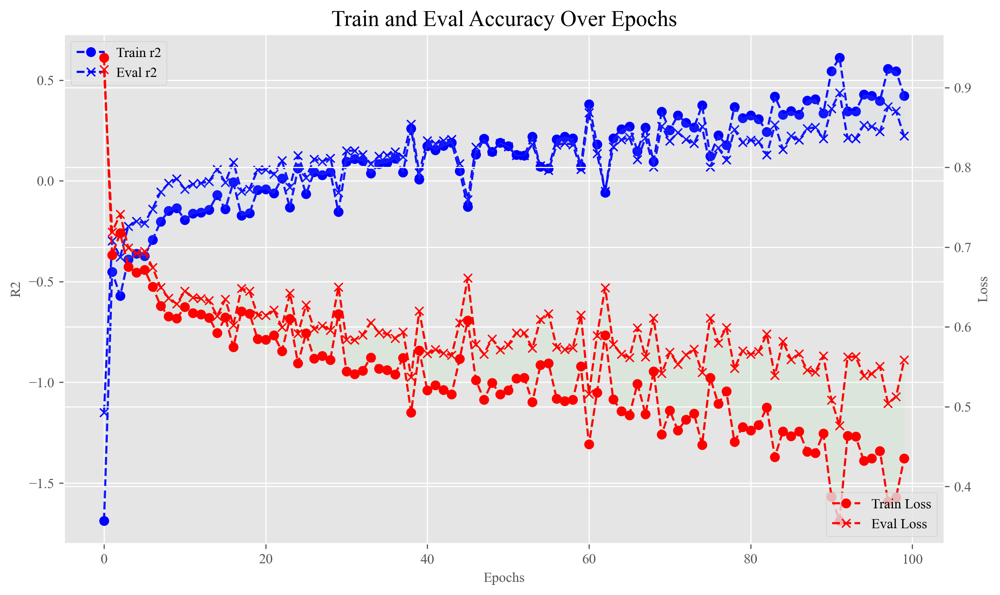

[I 2024-05-05 18:30:51,133] Trial 3 finished with value: 0.47633710503578186 and parameters: {'num_blocks': 4, 'dropout': 0.11154800047367393, 'purns': 0.15286082165729004, 'lr': 1.2491730632958377e-05}. Best is trial 0 with value: 0.47462546825408936.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss1.6522849798202515 eval_loss:1.6628702878952026 trainr2 -7.334726423901634 evalr2 -6.009370341564146
train_loss0.6226067543029785 eval_loss:0.6763415932655334 trainr2 -0.18174428760652894 evalr2 -0.1428894297557084
train_loss0.7561743259429932 eval_loss:0.8003415465354919 trainr2 -0.7443451171503175 evalr2 -0.6048067646506445
train_loss0.7280531525611877 eval_loss:0.7709161639213562 trainr2 -0.6143058447945442 evalr2 -0.48788726140897376
train_loss0.7226836085319519 eval_loss:0.7660203576087952 trainr2 -0.5929743423327523 evalr2 -0.4688588475782791
train_loss0.7298315763473511 eval_loss:0.7716251611709595 trainr2 -0.6196083720494518 evalr2 -0.4906864328055276
train_loss0.7130295038223267 eval_loss:0.7557716965675354 trainr2 -0.5534748829204714 evalr2 -0.4294813075837163
train_loss0.7271556258201599 eval_loss:0.7667775750160217 trainr2 -0.6178884558216382 evalr2 -0.47227595380552123
train_loss0.6764870285987854 eval_loss:0.7167271971702576 trainr2 -0.39851127261701524 evalr2 -

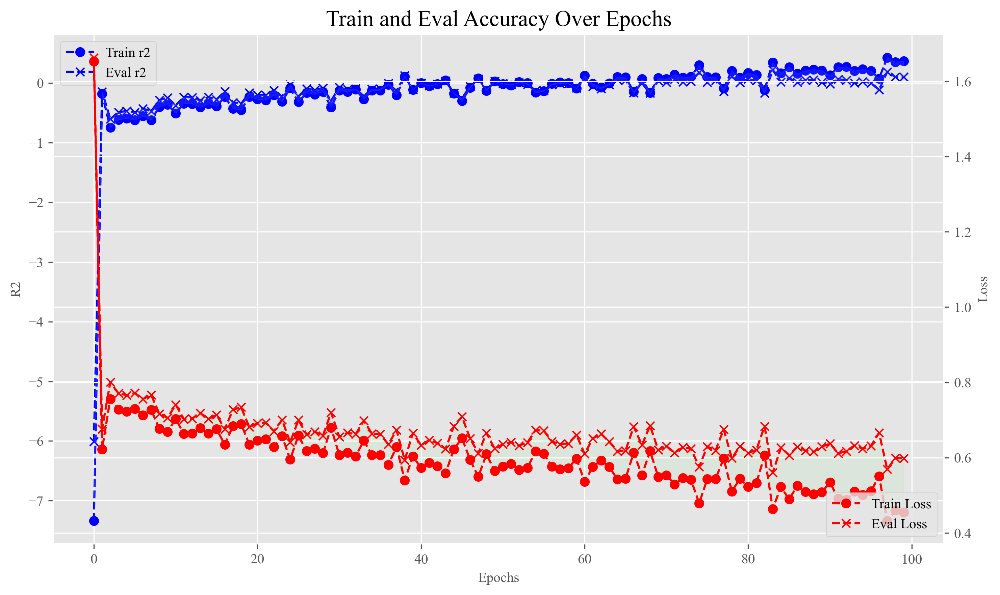

[I 2024-05-05 18:36:13,399] Trial 4 finished with value: 0.5600401163101196 and parameters: {'num_blocks': 3, 'dropout': 0.16418531462358021, 'purns': 0.2181216289323346, 'lr': 2.554756678453333e-05}. Best is trial 0 with value: 0.47462546825408936.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss1.9050648212432861 eval_loss:1.9225322008132935 trainr2 -10.07847413796504 evalr2 -8.371919480979255
train_loss0.9110941886901855 eval_loss:0.9515807628631592 trainr2 -1.5296626873598158 evalr2 -1.273248821167424
train_loss0.9180344939231873 eval_loss:0.9522849321365356 trainr2 -1.5713033779056906 evalr2 -1.2771267847756183
train_loss0.9067550897598267 eval_loss:0.9371210336685181 trainr2 -1.504110749471562 evalr2 -1.2049933385682965
train_loss0.9000433683395386 eval_loss:0.9306111335754395 trainr2 -1.4699731943143757 evalr2 -1.1742167484186319
train_loss0.9109665155410767 eval_loss:0.9397077560424805 trainr2 -1.5242747082378258 evalr2 -1.217456327860703
train_loss0.8865604400634766 eval_loss:0.9132763743400574 trainr2 -1.3999227041776514 evalr2 -1.0939886293389267
train_loss0.9414440989494324 eval_loss:0.9617999792098999 trainr2 -1.7096331474112314 evalr2 -1.3262467810202807
train_loss0.8982388973236084 eval_loss:0.9151774644851685 trainr2 -1.4639408929653497 evalr2 -1.10711

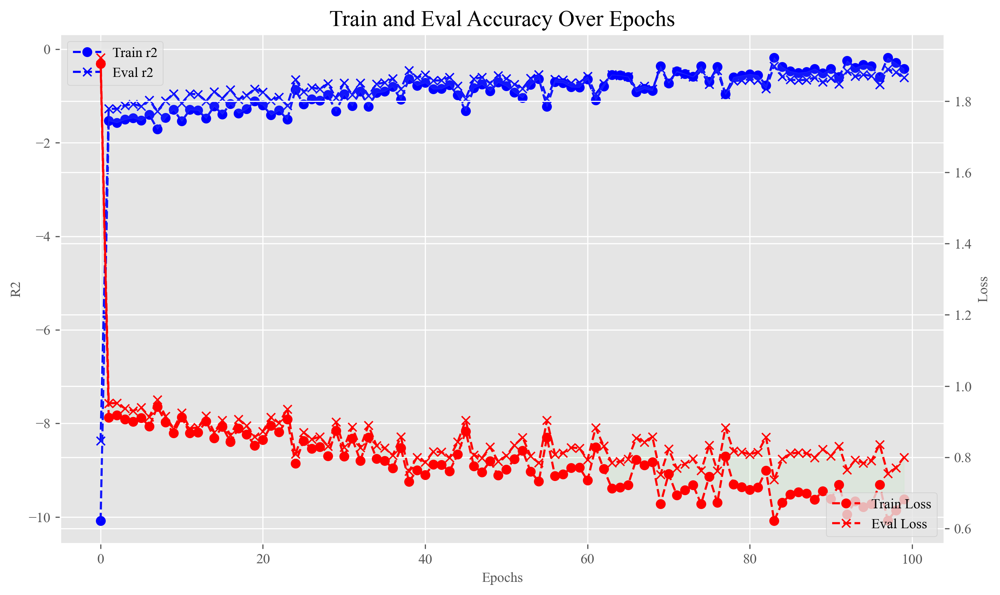

[I 2024-05-05 18:40:16,750] Trial 5 finished with value: 0.7368226051330566 and parameters: {'num_blocks': 2, 'dropout': 0.2296293991737287, 'purns': 0.26508086524795804, 'lr': 6.104206769100752e-05}. Best is trial 0 with value: 0.47462546825408936.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.6370905637741089 eval_loss:0.6858271956443787 trainr2 -0.24258381887102431 evalr2 -0.1729522939709529
train_loss0.6082826256752014 eval_loss:0.6357635259628296 trainr2 -0.12625156585499164 evalr2 -0.009576941554726881
train_loss0.48837190866470337 eval_loss:0.5312619805335999 trainr2 0.2724040031301683 evalr2 0.29306764793817086
train_loss0.41849568486213684 eval_loss:0.49628832936286926 trainr2 0.46712741695767446 evalr2 0.3891975828542906
train_loss0.4184969365596771 eval_loss:0.5069593191146851 trainr2 0.46590785397394097 evalr2 0.3613062774119057
train_loss0.3931608200073242 eval_loss:0.4854753911495209 trainr2 0.5295805327719373 evalr2 0.41437603480488916
train_loss0.41776010394096375 eval_loss:0.5271065831184387 trainr2 0.4672852238043844 evalr2 0.30491219650550605
train_loss0.5178084969520569 eval_loss:0.6317084431648254 trainr2 0.180123435435246 evalr2 0.009422141103333392
train_loss0.38505735993385315 eval_loss:0.5115101337432861 trainr2 0.5469156376143287 evalr2 0

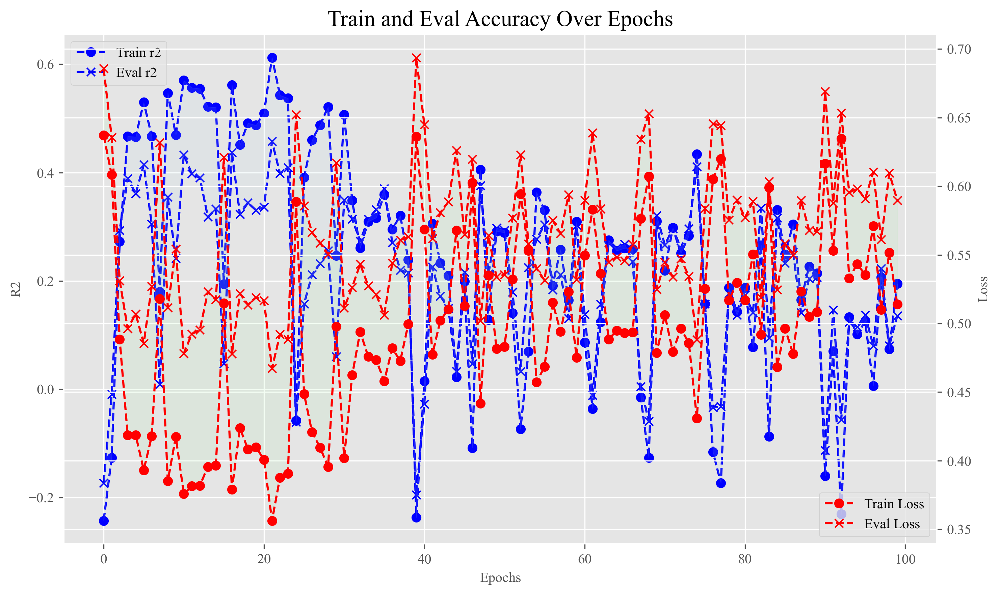

[I 2024-05-05 18:45:35,430] Trial 6 finished with value: 0.4672769010066986 and parameters: {'num_blocks': 3, 'dropout': 0.13809919851849567, 'purns': 0.10798244326163607, 'lr': 0.002138213066215411}. Best is trial 6 with value: 0.4672769010066986.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.9264708757400513 eval_loss:0.9773957133293152 trainr2 -1.6245299944683222 evalr2 -1.4002960292366682
train_loss0.5751469731330872 eval_loss:0.6214088797569275 trainr2 -0.00827548295159497 evalr2 0.03768103921848853
train_loss0.5624620318412781 eval_loss:0.595015823841095 trainr2 0.03502028411151048 evalr2 0.11835692815108256
train_loss0.5860556364059448 eval_loss:0.6104057431221008 trainr2 -0.04601770119813686 evalr2 0.0713508383095347
train_loss0.5707806944847107 eval_loss:0.5961224436759949 trainr2 0.006093331374274813 evalr2 0.11470967476839988
train_loss0.5795875787734985 eval_loss:0.6027480959892273 trainr2 -0.022282149109278837 evalr2 0.09462053174415253
train_loss0.5718532800674438 eval_loss:0.5927150845527649 trainr2 0.00015900515911082547 evalr2 0.12423623976615183
train_loss0.5455291271209717 eval_loss:0.5702937841415405 trainr2 0.08909455081704931 evalr2 0.18914613756281284
train_loss0.5744284391403198 eval_loss:0.6037341952323914 trainr2 -0.006903952572127725 ev

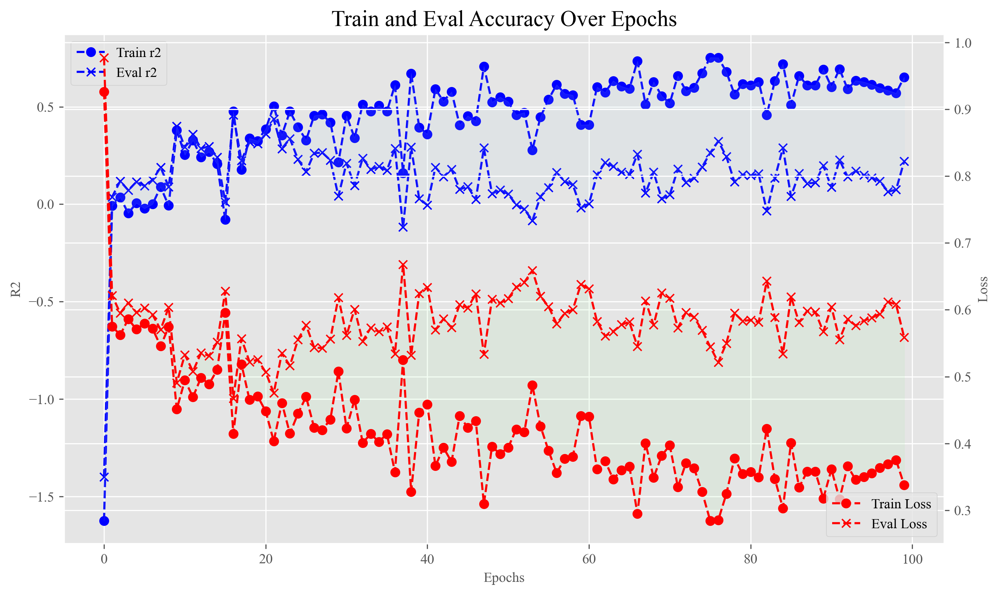

[I 2024-05-05 18:50:56,926] Trial 7 finished with value: 0.4677585959434509 and parameters: {'num_blocks': 3, 'dropout': 0.19205047407426928, 'purns': 0.1442049303594326, 'lr': 0.00019926699517717957}. Best is trial 6 with value: 0.4672769010066986.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5664889812469482 eval_loss:0.6187529563903809 trainr2 0.01978889984143839 evalr2 0.03975287821148876
train_loss0.5591578483581543 eval_loss:0.6114521622657776 trainr2 0.04689276139900311 evalr2 0.06830746497004436
train_loss0.5483327507972717 eval_loss:0.5839177370071411 trainr2 0.08319782181907909 evalr2 0.15225723722643392
train_loss0.5570129752159119 eval_loss:0.5800963640213013 trainr2 0.05486305585540918 evalr2 0.16344291399703437
train_loss0.5447025895118713 eval_loss:0.5683721303939819 trainr2 0.09471540150777302 evalr2 0.19701167335185377
train_loss0.5489261746406555 eval_loss:0.570120096206665 trainr2 0.08307202518789181 evalr2 0.1919994897325844
train_loss0.5349779725074768 eval_loss:0.5505783557891846 trainr2 0.12424319049924493 evalr2 0.2461284435925799
train_loss0.49566763639450073 eval_loss:0.5168197751045227 trainr2 0.2479261484868095 evalr2 0.3364262147112712
train_loss0.46058812737464905 eval_loss:0.5121395587921143 trainr2 0.3530283709999822 evalr2 0.35356

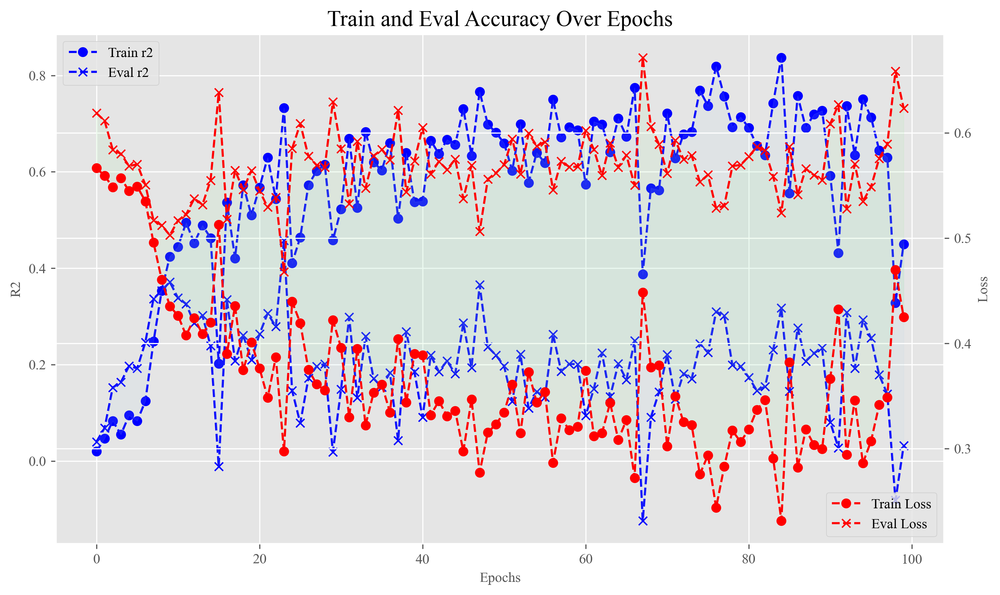

[I 2024-05-05 19:00:02,706] Trial 8 finished with value: 0.46797847747802734 and parameters: {'num_blocks': 6, 'dropout': 0.2802997607333899, 'purns': 0.29731725846183465, 'lr': 0.00046627168994307433}. Best is trial 6 with value: 0.4672769010066986.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.733211100101471 eval_loss:0.7908309698104858 trainr2 -0.645070248296354 evalr2 -0.5639133747268208
train_loss0.6105821132659912 eval_loss:0.6611489057540894 trainr2 -0.13629251422413446 evalr2 -0.08947097627073042
train_loss0.593178927898407 eval_loss:0.6167533993721008 trainr2 -0.0732100018844446 evalr2 0.05323424623756989
train_loss0.5639783143997192 eval_loss:0.579875111579895 trainr2 0.03104815409545847 evalr2 0.16339119335272223
train_loss0.5726266503334045 eval_loss:0.5867170691490173 trainr2 -0.0004784225809038034 evalr2 0.14323806119397386
train_loss0.5748094916343689 eval_loss:0.5864275097846985 trainr2 -0.005520574509285003 evalr2 0.14400794700779773
train_loss0.560585618019104 eval_loss:0.5707807540893555 trainr2 0.03849004992126581 evalr2 0.18927406103699007
train_loss0.5640167593955994 eval_loss:0.6130200624465942 trainr2 0.026628943152483098 evalr2 0.06197731593804001
train_loss0.413711816072464 eval_loss:0.48785656690597534 trainr2 0.47758093020986114 evalr2 

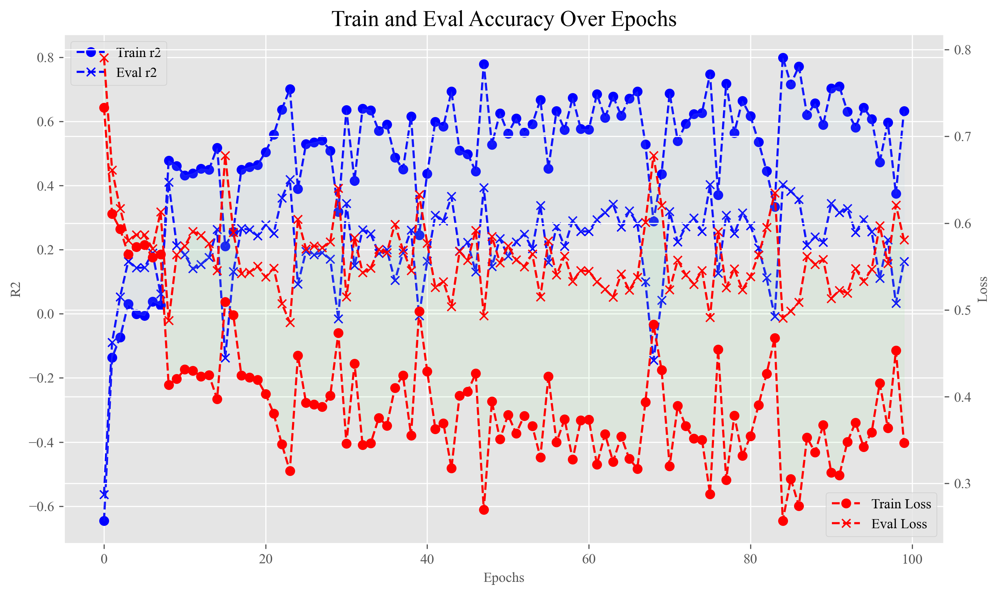

[I 2024-05-05 19:07:56,916] Trial 9 finished with value: 0.4855858385562897 and parameters: {'num_blocks': 5, 'dropout': 0.2903493158884352, 'purns': 0.20405189337278123, 'lr': 0.0006711896385815648}. Best is trial 6 with value: 0.4672769010066986.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.6520848274230957 eval_loss:0.6923289895057678 trainr2 -0.29650052192548704 evalr2 -0.21235631048866632
train_loss0.5717397332191467 eval_loss:0.6300410628318787 trainr2 0.0035824861695248345 evalr2 0.005927628619451175
train_loss0.5732526183128357 eval_loss:0.6347375512123108 trainr2 -0.0016315337524193119 evalr2 -0.00661666734280586
train_loss0.5651831030845642 eval_loss:0.6234498023986816 trainr2 0.026822619543218185 evalr2 0.02763016021700082
train_loss0.5701426863670349 eval_loss:0.6311675310134888 trainr2 0.009188671755482658 evalr2 0.005107153998436087
train_loss0.5727964639663696 eval_loss:0.6338931918144226 trainr2 0.0008972137104683586 evalr2 -0.0030995132027564765
train_loss0.5904772281646729 eval_loss:0.651458740234375 trainr2 -0.06583610916850069 evalr2 -0.05784282877828062
train_loss0.5131088495254517 eval_loss:0.5631371736526489 trainr2 0.19428874062360724 evalr2 0.20971216609230114
train_loss0.6200737357139587 eval_loss:0.657489538192749 trainr2 -0.1729982965

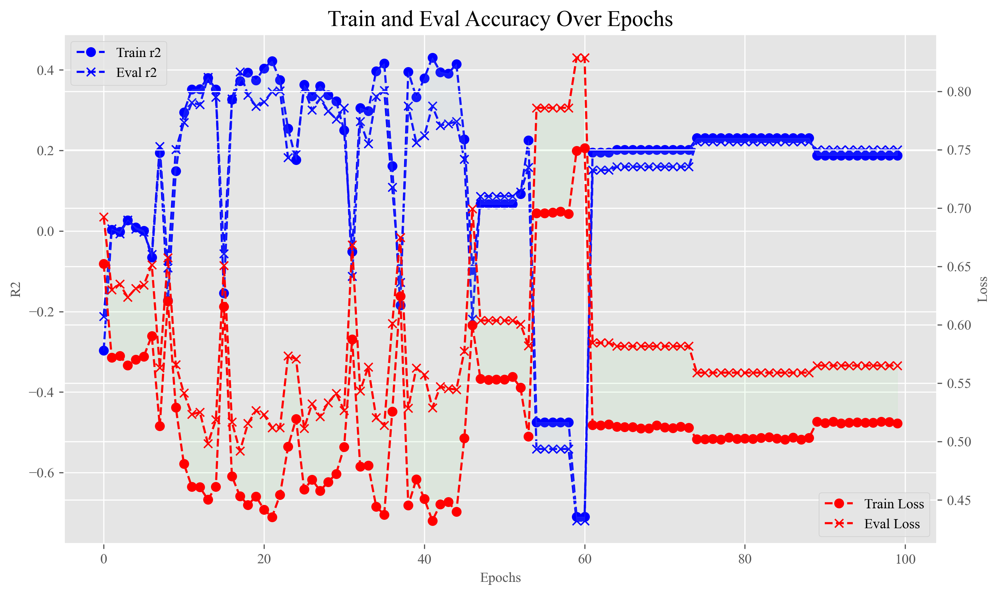

[I 2024-05-05 19:19:28,240] Trial 10 finished with value: 0.49174103140830994 and parameters: {'num_blocks': 8, 'dropout': 0.103123246043841, 'purns': 0.11971427415681052, 'lr': 0.004868621643765289}. Best is trial 6 with value: 0.4672769010066986.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.8455362319946289 eval_loss:0.8978589177131653 trainr2 -1.1871479418947315 evalr2 -1.0211118202424858
train_loss0.5467268824577332 eval_loss:0.5939263701438904 trainr2 0.08870244756510592 evalr2 0.12153902945280859
train_loss0.5266247391700745 eval_loss:0.5641251802444458 trainr2 0.15438750463967543 evalr2 0.2079702744831765
train_loss0.5424767732620239 eval_loss:0.5739073157310486 trainr2 0.10354752936600298 evalr2 0.18025592088394804
train_loss0.5350651741027832 eval_loss:0.5667781829833984 trainr2 0.12660012042124213 evalr2 0.20050023058907163
train_loss0.5373920202255249 eval_loss:0.5676119327545166 trainr2 0.12092923365778563 evalr2 0.19811295074997792
train_loss0.538547694683075 eval_loss:0.5646548867225647 trainr2 0.11316468580876704 evalr2 0.20608331133832503
train_loss0.4868391454219818 eval_loss:0.5136479735374451 trainr2 0.27403230048573024 evalr2 0.3431000748358489
train_loss0.5214236974716187 eval_loss:0.5427053570747375 trainr2 0.17002362515891645 evalr2 0.2648

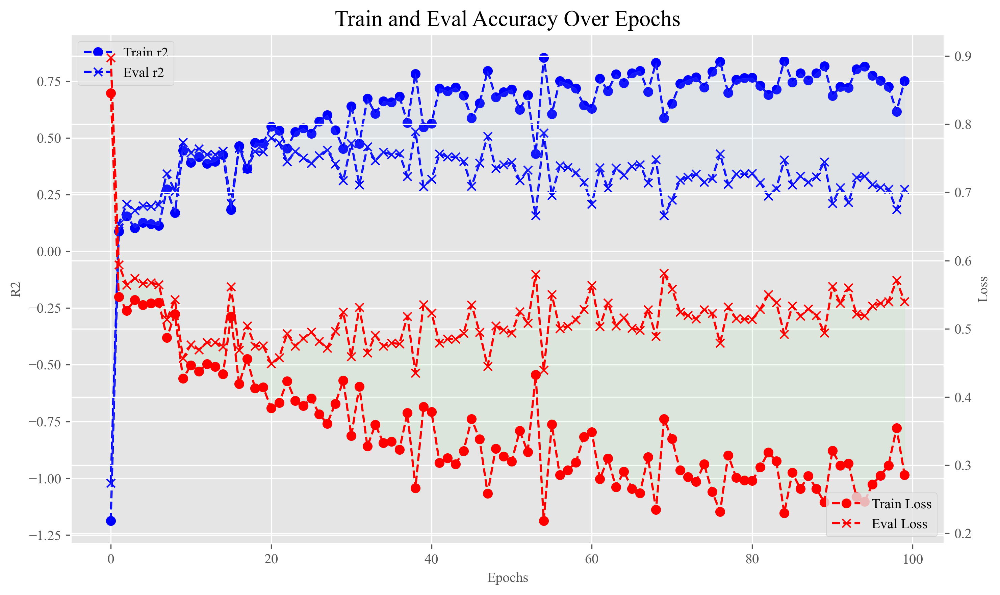

[I 2024-05-05 19:26:00,011] Trial 11 finished with value: 0.43524622917175293 and parameters: {'num_blocks': 4, 'dropout': 0.17042865248569272, 'purns': 0.1035443368400778, 'lr': 0.00015224722562727933}. Best is trial 11 with value: 0.43524622917175293.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5525094270706177 eval_loss:0.6091307401657104 trainr2 0.06615190768299439 evalr2 0.07428671755551886
train_loss0.7639970779418945 eval_loss:0.53895503282547 trainr2 -0.7866020425174183 evalr2 0.27785409833590435
train_loss0.6482143998146057 eval_loss:0.63579922914505 trainr2 -0.2829142020847364 evalr2 -0.011774577315162293
train_loss0.5978288054466248 eval_loss:0.659883975982666 trainr2 -0.08832947721310203 evalr2 -0.08751044896215365
train_loss0.5799388289451599 eval_loss:0.6411962509155273 trainr2 -0.025229839771378382 evalr2 -0.027180182198067948
train_loss0.5829150676727295 eval_loss:0.6439396142959595 trainr2 -0.03455316237717465 evalr2 -0.03578109691391451
train_loss0.5818276405334473 eval_loss:0.6435883641242981 trainr2 -0.034740582449543034 evalr2 -0.034048455436749725
train_loss0.5922585725784302 eval_loss:0.6515892148017883 trainr2 -0.0749812274390691 evalr2 -0.05918977868729347
train_loss0.5851453542709351 eval_loss:0.6398753523826599 trainr2 -0.04722932669628288

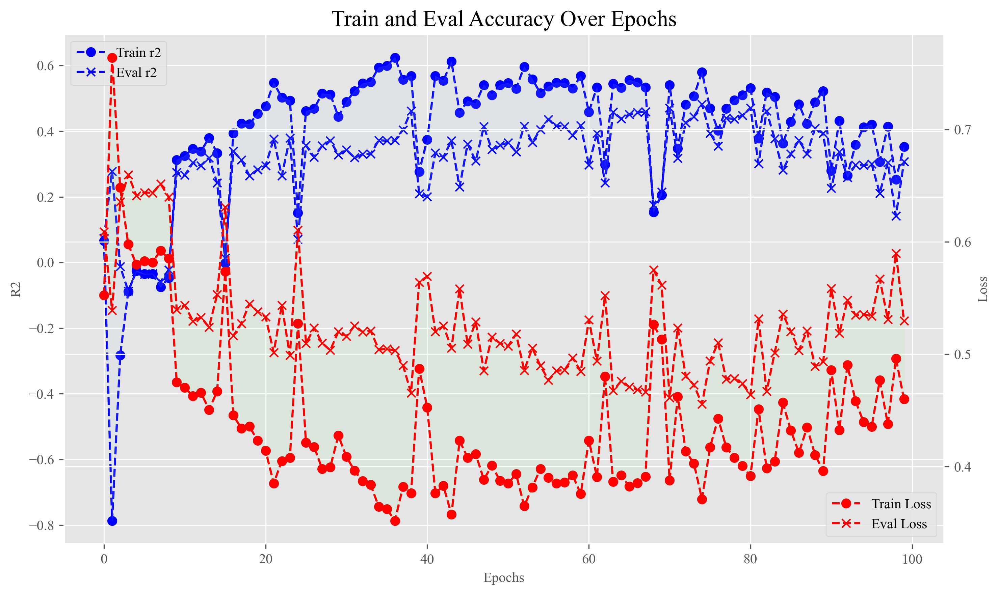

[I 2024-05-05 19:34:06,564] Trial 12 finished with value: 0.4557032883167267 and parameters: {'num_blocks': 5, 'dropout': 0.14776054443042075, 'purns': 0.10940461887829163, 'lr': 0.0015625267175157765}. Best is trial 11 with value: 0.43524622917175293.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.7429232001304626 eval_loss:0.7913908958435059 trainr2 -0.688909497081057 evalr2 -0.5673540610083396
train_loss0.531766414642334 eval_loss:0.5794516801834106 trainr2 0.13763360340437503 evalr2 0.16091706626628188
train_loss0.5311527252197266 eval_loss:0.5728184580802917 trainr2 0.13988306280170615 evalr2 0.18221768763471258
train_loss0.5323610901832581 eval_loss:0.5708247423171997 trainr2 0.13672983724962517 evalr2 0.18815405809016406
train_loss0.5316098928451538 eval_loss:0.5700773000717163 trainr2 0.13771103488245884 evalr2 0.19031175273805057
train_loss0.5320800542831421 eval_loss:0.5693941116333008 trainr2 0.13811052591064288 evalr2 0.19227717454484983
train_loss0.5373809337615967 eval_loss:0.572179913520813 trainr2 0.11693657515604527 evalr2 0.18440283203335484
train_loss0.48790138959884644 eval_loss:0.5257469415664673 trainr2 0.27178028249156483 evalr2 0.3098015276257641
train_loss0.5473731756210327 eval_loss:0.5769537091255188 trainr2 0.08451175124309818 evalr2 0.1694

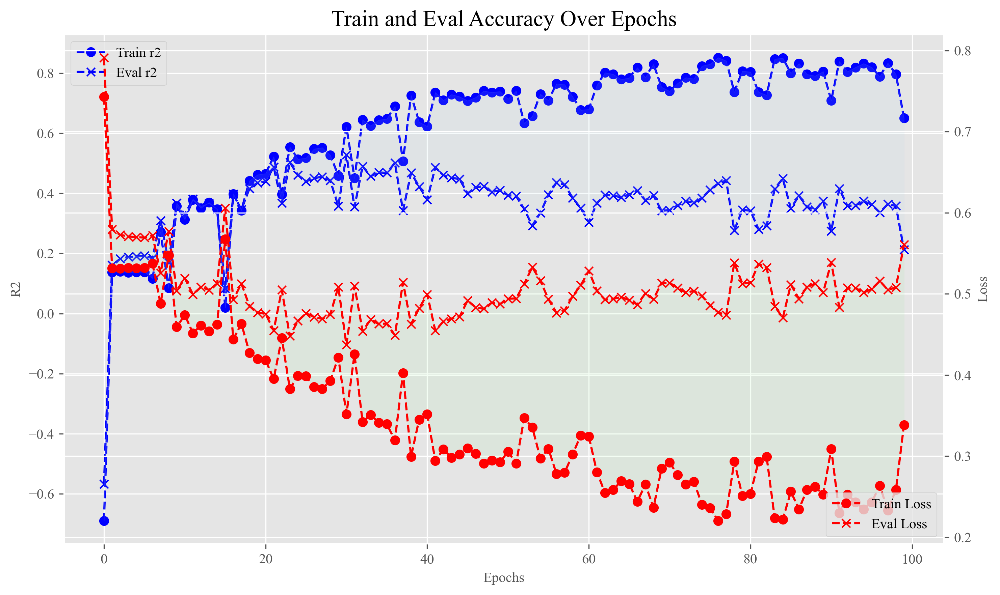

[I 2024-05-05 19:44:58,884] Trial 13 finished with value: 0.4371509253978729 and parameters: {'num_blocks': 6, 'dropout': 0.16301942255190688, 'purns': 0.10596989330427325, 'lr': 8.626036256549624e-05}. Best is trial 11 with value: 0.43524622917175293.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.7762758135795593 eval_loss:0.8246279358863831 trainr2 -0.843867210014011 evalr2 -0.7038148780975209
train_loss0.5300706624984741 eval_loss:0.581718921661377 trainr2 0.14312561233304322 evalr2 0.154470845595311
train_loss0.519950270652771 eval_loss:0.5623490810394287 trainr2 0.1758208869778266 evalr2 0.2120047350077916
train_loss0.5208559632301331 eval_loss:0.5576241612434387 trainr2 0.1736569186339353 evalr2 0.22574655231936924
train_loss0.519679069519043 eval_loss:0.5562674403190613 trainr2 0.17598198358265882 evalr2 0.22954036399798483
train_loss0.518674373626709 eval_loss:0.5541132688522339 trainr2 0.18093487009742737 evalr2 0.23550414696651234
train_loss0.5207234621047974 eval_loss:0.5518069863319397 trainr2 0.17061111655910755 evalr2 0.24207326778007088
train_loss0.47349244356155396 eval_loss:0.5081183910369873 trainr2 0.3140971616868191 evalr2 0.35618346785100374
train_loss0.5033299922943115 eval_loss:0.5297229290008545 trainr2 0.22613964915565532 evalr2 0.30175751945

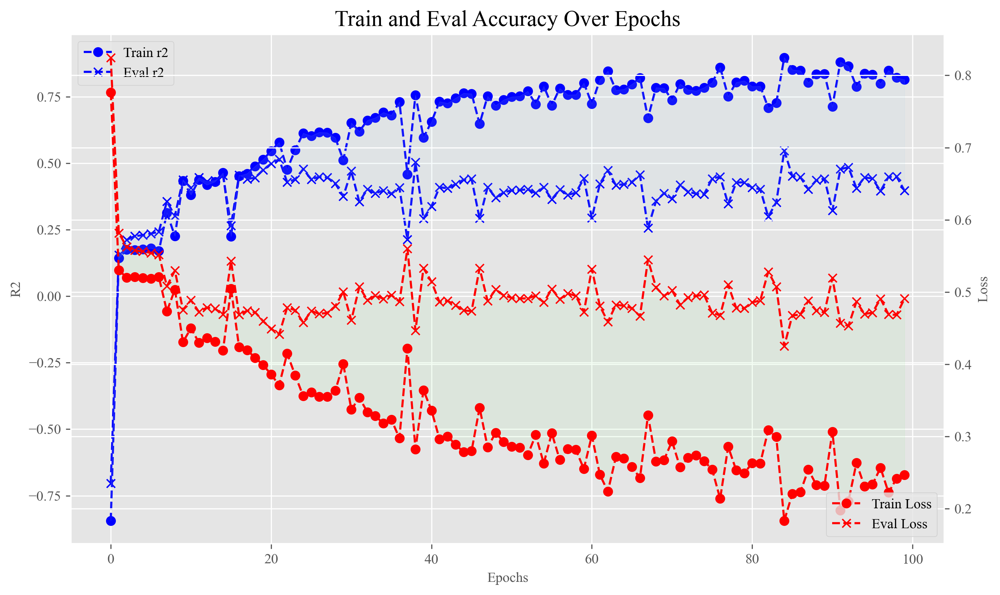

[I 2024-05-05 19:58:20,008] Trial 14 finished with value: 0.4253198504447937 and parameters: {'num_blocks': 7, 'dropout': 0.18103703414305827, 'purns': 0.14808572893401126, 'lr': 0.00010032848705862238}. Best is trial 14 with value: 0.4253198504447937.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.7408618330955505 eval_loss:0.8005201816558838 trainr2 -0.6795477749552226 evalr2 -0.6052963340071791
train_loss0.5348208546638489 eval_loss:0.5890570878982544 trainr2 0.1277624610905076 evalr2 0.13169866406811703
train_loss0.5286914706230164 eval_loss:0.5778167247772217 trainr2 0.14791162034618055 evalr2 0.16702309618337408
train_loss0.5254783034324646 eval_loss:0.5704476237297058 trainr2 0.1590275226088005 evalr2 0.18850494226829362
train_loss0.5234895944595337 eval_loss:0.5682036876678467 trainr2 0.16412090840660343 evalr2 0.19489712213475674
train_loss0.5243138074874878 eval_loss:0.5677902102470398 trainr2 0.16294560797407198 evalr2 0.19614219399602362
train_loss0.5257896780967712 eval_loss:0.5652816295623779 trainr2 0.15455115026728683 evalr2 0.2034369175015842
train_loss0.49109455943107605 eval_loss:0.5278121829032898 trainr2 0.261919454725691 evalr2 0.30524114113116385
train_loss0.536666989326477 eval_loss:0.5643263459205627 trainr2 0.12002482336371345 evalr2 0.205207

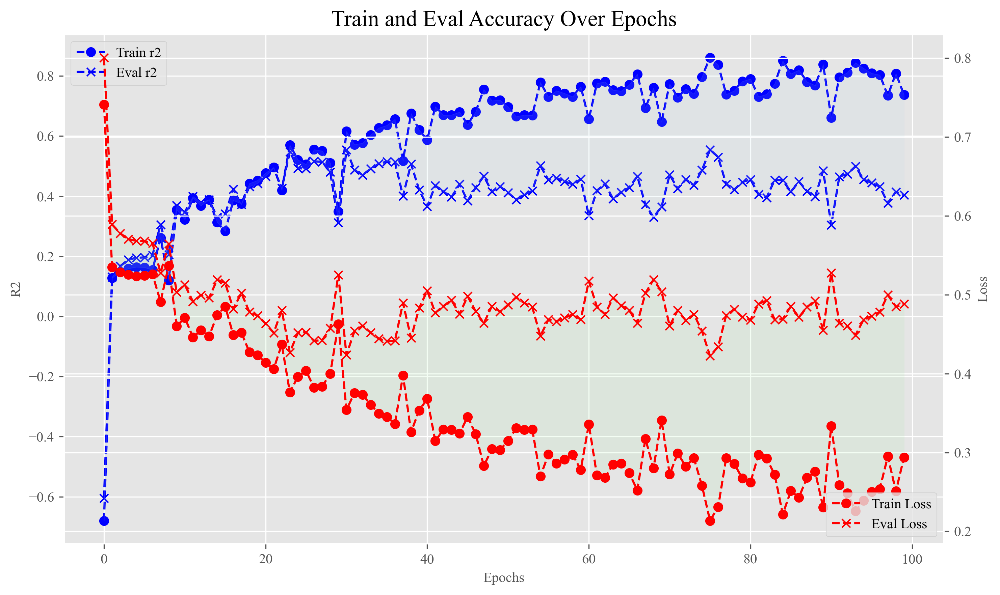

[I 2024-05-05 20:12:31,851] Trial 15 finished with value: 0.42235809564590454 and parameters: {'num_blocks': 8, 'dropout': 0.18900696101004555, 'purns': 0.1500118651222936, 'lr': 8.349878038793798e-05}. Best is trial 15 with value: 0.42235809564590454.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.7090622782707214 eval_loss:0.7444075345993042 trainr2 -0.5317168007880988 evalr2 -0.4055810424145365
train_loss0.5848355293273926 eval_loss:0.6385601758956909 trainr2 -0.04282332092059038 evalr2 -0.01675763780079298
train_loss0.5432866215705872 eval_loss:0.5903050303459167 trainr2 0.10003173707196833 evalr2 0.13172388466043072
train_loss0.537304699420929 eval_loss:0.5808294415473938 trainr2 0.12044536428600394 evalr2 0.15966692446424824
train_loss0.541749894618988 eval_loss:0.5846656560897827 trainr2 0.10490703079579344 evalr2 0.14866302065647607
train_loss0.5410942435264587 eval_loss:0.5829938650131226 trainr2 0.10834868316390112 evalr2 0.15357436167567784
train_loss0.5509576201438904 eval_loss:0.588157594203949 trainr2 0.07176543282918557 evalr2 0.13872730871150385
train_loss0.4956973195075989 eval_loss:0.5310548543930054 trainr2 0.24809654485417898 evalr2 0.2973515931031785
train_loss0.5733376145362854 eval_loss:0.5924974679946899 trainr2 -0.004460803093902843 evalr2 0.1

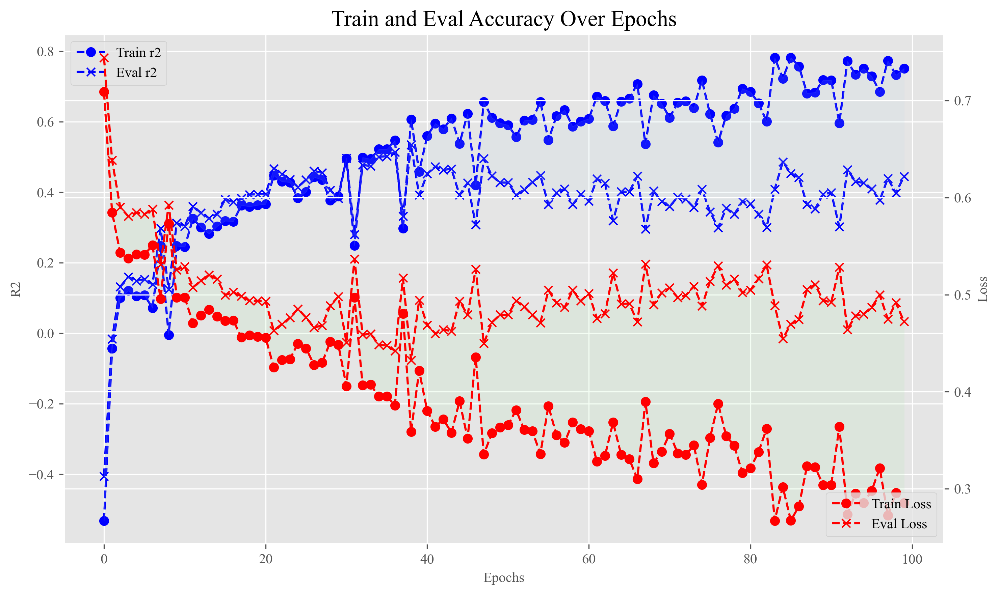

[I 2024-05-05 20:24:31,688] Trial 16 finished with value: 0.43243226408958435 and parameters: {'num_blocks': 8, 'dropout': 0.19518946481056776, 'purns': 0.16631108612384754, 'lr': 4.4814174546230396e-05}. Best is trial 15 with value: 0.42235809564590454.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.6063403487205505 eval_loss:0.668699324131012 trainr2 -0.12528684936934575 evalr2 -0.11698113016882128
train_loss0.5472089648246765 eval_loss:0.6024893522262573 trainr2 0.08683831835287414 evalr2 0.09326878121941606
train_loss0.5483913421630859 eval_loss:0.5969848036766052 trainr2 0.08302374311748839 evalr2 0.11152077178969122
train_loss0.5394877791404724 eval_loss:0.5839825868606567 trainr2 0.11355481805311096 evalr2 0.15006603017003117
train_loss0.5419299006462097 eval_loss:0.5857744216918945 trainr2 0.104283088522242 evalr2 0.1449775710960196
train_loss0.5395931601524353 eval_loss:0.5822557806968689 trainr2 0.11357206962061606 evalr2 0.15524714030853637
train_loss0.5572046637535095 eval_loss:0.5929939150810242 trainr2 0.050625371670432795 evalr2 0.12408014920949162
train_loss0.4973973333835602 eval_loss:0.5317153930664062 trainr2 0.24290660306663003 evalr2 0.2953399902963272
train_loss0.55533766746521 eval_loss:0.5787147283554077 trainr2 0.057799991426235375 evalr2 0.1643

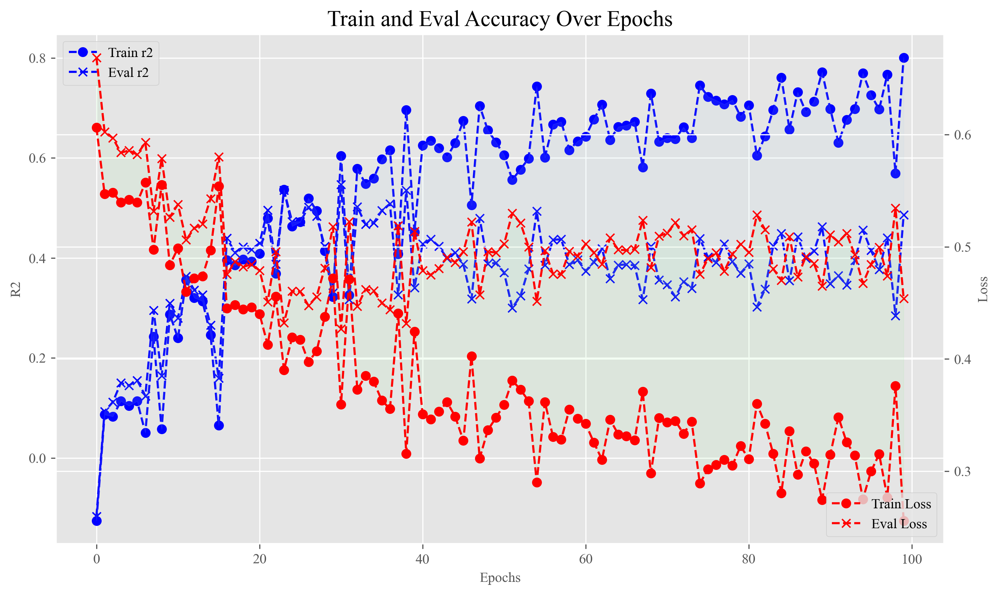

[I 2024-05-05 20:34:54,409] Trial 17 finished with value: 0.42686930298805237 and parameters: {'num_blocks': 7, 'dropout': 0.2185849821318001, 'purns': 0.1687416047791672, 'lr': 9.324098455556835e-05}. Best is trial 15 with value: 0.42235809564590454.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5717329978942871 eval_loss:0.6312340497970581 trainr2 0.0002802739876162086 evalr2 0.003789147886304911
train_loss0.5501142740249634 eval_loss:0.6055276393890381 trainr2 0.07715079866393804 evalr2 0.08422141861412624
train_loss0.5619314312934875 eval_loss:0.6135134696960449 trainr2 0.03714337886683905 evalr2 0.06203601097007949
train_loss0.5533270835876465 eval_loss:0.6019290685653687 trainr2 0.06764304658804832 evalr2 0.09729303549806889
train_loss0.5538638234138489 eval_loss:0.6025148034095764 trainr2 0.06411608442608596 evalr2 0.09559342607666299
train_loss0.5549623370170593 eval_loss:0.602536141872406 trainr2 0.06220780680338367 evalr2 0.09556642250709291
train_loss0.5625912547111511 eval_loss:0.6072195768356323 trainr2 0.0323317572089441 evalr2 0.08154388302045024
train_loss0.506429135799408 eval_loss:0.5478091835975647 trainr2 0.21497274265777055 evalr2 0.2520794783545982
train_loss0.5473905205726624 eval_loss:0.5818701982498169 trainr2 0.08405516481911979 evalr2 0.15

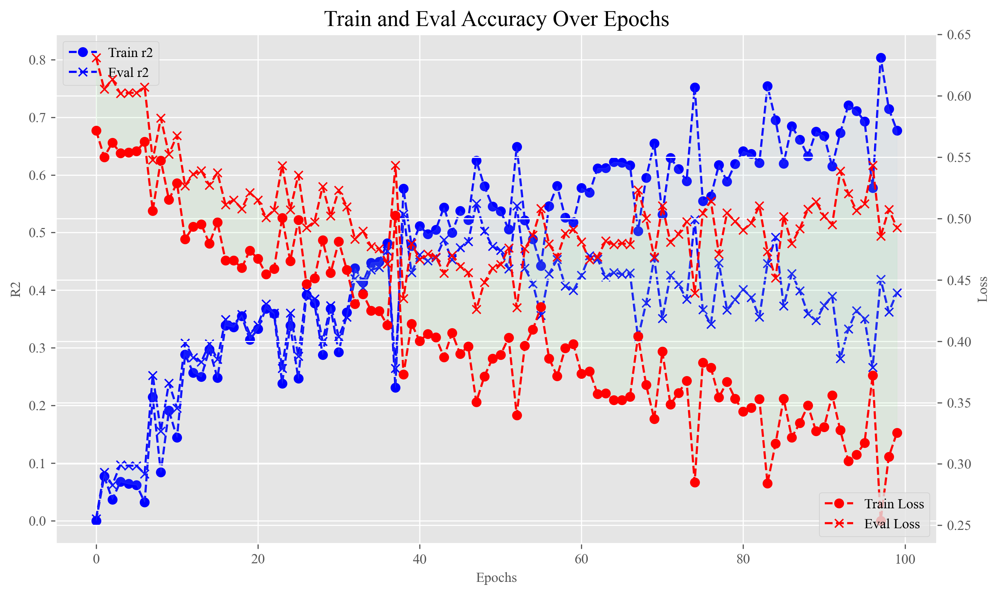

[I 2024-05-05 20:45:16,742] Trial 18 finished with value: 0.42592403292655945 and parameters: {'num_blocks': 7, 'dropout': 0.1841634832389722, 'purns': 0.13336191203951414, 'lr': 3.600822547287979e-05}. Best is trial 15 with value: 0.42235809564590454.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.8122215270996094 eval_loss:0.8616496324539185 trainr2 -1.0179684607586381 evalr2 -0.8610552289268152
train_loss0.543322741985321 eval_loss:0.595538854598999 trainr2 0.09985969419660423 evalr2 0.11462813458526355
train_loss0.5303177833557129 eval_loss:0.5747711062431335 trainr2 0.14263005835697484 evalr2 0.1761217153425152
train_loss0.5326101183891296 eval_loss:0.5712881088256836 trainr2 0.13608698525748608 evalr2 0.1864923576242853
train_loss0.5296177864074707 eval_loss:0.5682080984115601 trainr2 0.14429382162999793 evalr2 0.19521309071623028
train_loss0.5286217331886292 eval_loss:0.5659437775611877 trainr2 0.1492987885211543 evalr2 0.201615277965421
train_loss0.5350159406661987 eval_loss:0.5668267607688904 trainr2 0.12474319818283586 evalr2 0.1991389390766175
train_loss0.5031422972679138 eval_loss:0.5325047373771667 trainr2 0.22493317526529444 evalr2 0.29308098139197303
train_loss0.5530508756637573 eval_loss:0.5672293305397034 trainr2 0.0653173644240237 evalr2 0.1963082445

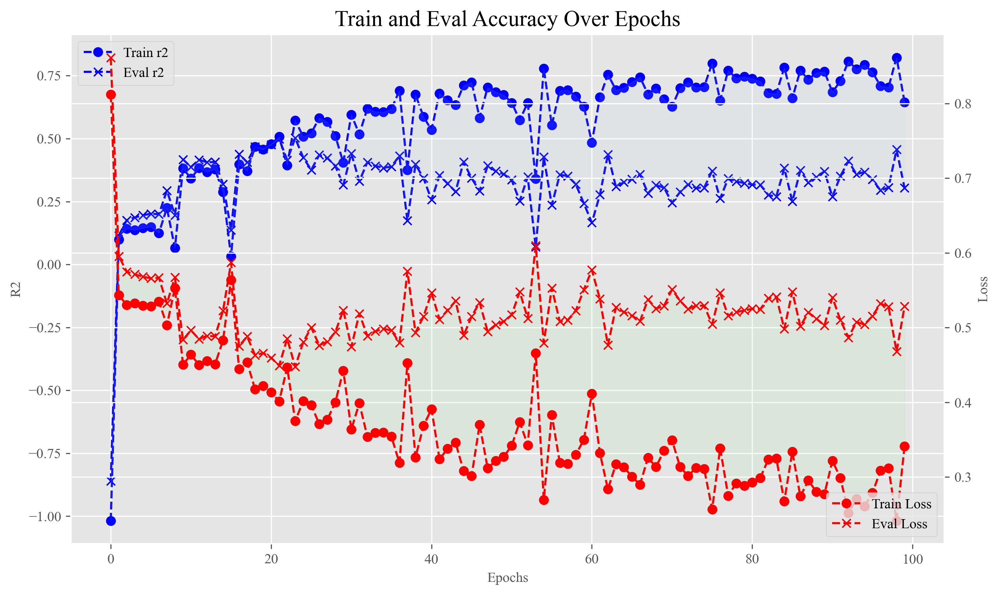

[I 2024-05-05 20:55:38,088] Trial 19 finished with value: 0.44754478335380554 and parameters: {'num_blocks': 7, 'dropout': 0.22989761161440608, 'purns': 0.17822401825015982, 'lr': 0.00012025646033123333}. Best is trial 15 with value: 0.42235809564590454.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5832120180130005 eval_loss:0.6444645524024963 trainr2 -0.04083243976126427 evalr2 -0.03675263425472153
train_loss0.556822657585144 eval_loss:0.6058807969093323 trainr2 0.054872731167867284 evalr2 0.08515121934566017
train_loss0.538011908531189 eval_loss:0.564057469367981 trainr2 0.11728871409721575 evalr2 0.20828152846113834
train_loss0.5009549856185913 eval_loss:0.5251657962799072 trainr2 0.23561511336626118 evalr2 0.3136258010515507
train_loss0.4973796308040619 eval_loss:0.5217233300209045 trainr2 0.24533232549754735 evalr2 0.32257090715815306
train_loss0.4955448806285858 eval_loss:0.5187054872512817 trainr2 0.25247967934455573 evalr2 0.33041853448201386
train_loss0.48042401671409607 eval_loss:0.5047380328178406 trainr2 0.29350194082571035 evalr2 0.3659886861262779
train_loss0.5503039956092834 eval_loss:0.5792170763015747 trainr2 0.07318929112884154 evalr2 0.16114911909592666
train_loss0.39112305641174316 eval_loss:0.4288322925567627 trainr2 0.5327686546236973 evalr2 0.54

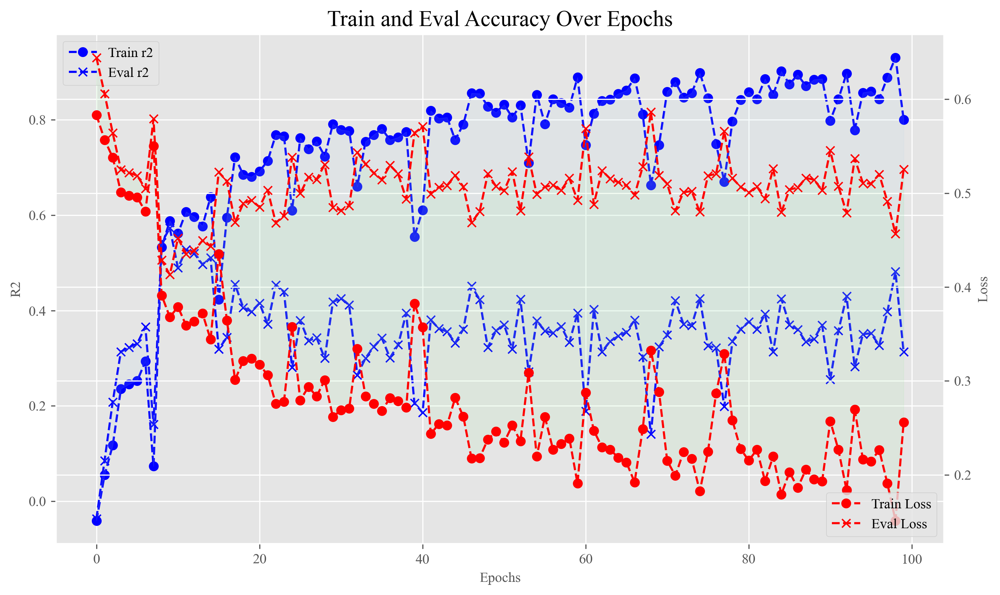

[I 2024-05-05 21:07:11,054] Trial 20 finished with value: 0.4131312966346741 and parameters: {'num_blocks': 8, 'dropout': 0.2031915206133889, 'purns': 0.13211929362573221, 'lr': 0.00030663468933292816}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5639600157737732 eval_loss:0.6234850287437439 trainr2 0.02703368133488071 evalr2 0.02905611677751696
train_loss0.5518605709075928 eval_loss:0.6006584167480469 trainr2 0.07157399460278069 evalr2 0.10051973838135886
train_loss0.5276598930358887 eval_loss:0.55667644739151 trainr2 0.15123764235829207 evalr2 0.22867677200653524
train_loss0.5040595531463623 eval_loss:0.5306685566902161 trainr2 0.22631643914675348 evalr2 0.2991312093512666
train_loss0.499812513589859 eval_loss:0.5269492268562317 trainr2 0.23768161631810092 evalr2 0.3089530488018475
train_loss0.49987900257110596 eval_loss:0.5251691937446594 trainr2 0.23938823846247415 evalr2 0.3137250182849033
train_loss0.4845738112926483 eval_loss:0.5086159110069275 trainr2 0.2811888436853097 evalr2 0.3566869836555111
train_loss0.5152509212493896 eval_loss:0.5596228241920471 trainr2 0.18733349526813403 evalr2 0.2185150924737742
train_loss0.40632718801498413 eval_loss:0.44491106271743774 trainr2 0.49609554052343596 evalr2 0.5086109

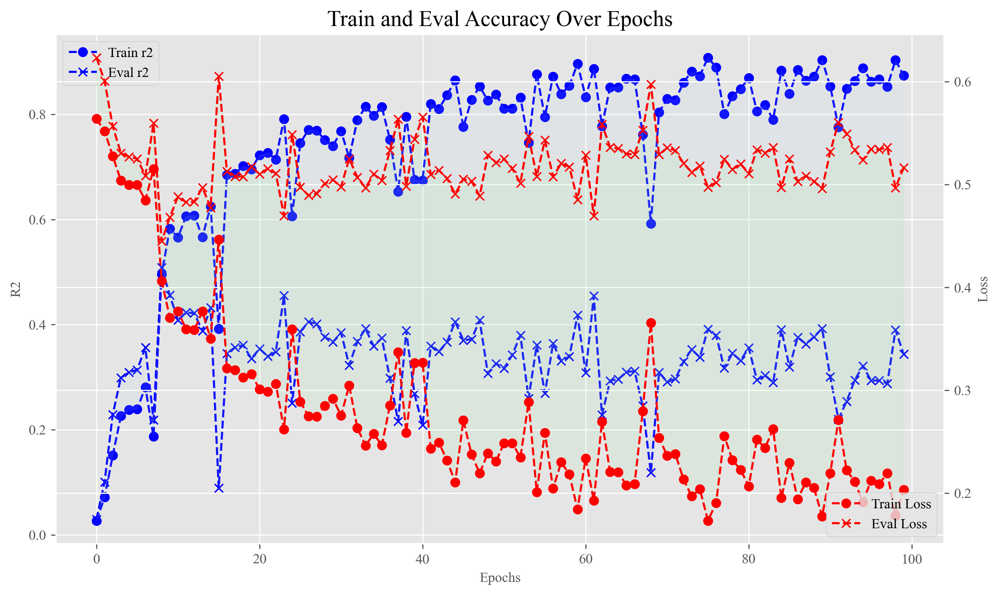

[I 2024-05-05 21:18:52,486] Trial 21 finished with value: 0.44491106271743774 and parameters: {'num_blocks': 8, 'dropout': 0.20339880299371307, 'purns': 0.14044110427200474, 'lr': 0.00032865281390239564}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5742745995521545 eval_loss:0.6326766014099121 trainr2 -0.009055331086789575 evalr2 0.0006689856227215518
train_loss0.552076518535614 eval_loss:0.6018983125686646 trainr2 0.07081750976902113 evalr2 0.0966238420672435
train_loss0.5244581699371338 eval_loss:0.5599154233932495 trainr2 0.1614739931869702 evalr2 0.2192381813158717
train_loss0.5155887603759766 eval_loss:0.5458993911743164 trainr2 0.19009007773967423 evalr2 0.25779100012631573
train_loss0.508044958114624 eval_loss:0.5398073792457581 trainr2 0.21271375998025255 evalr2 0.274043612654977
train_loss0.5092692971229553 eval_loss:0.5394036769866943 trainr2 0.21053687618517147 evalr2 0.275223341089037
train_loss0.49147626757621765 eval_loss:0.5214730501174927 trainr2 0.26090704336522785 evalr2 0.3223844723898325
train_loss0.4948125183582306 eval_loss:0.5175781846046448 trainr2 0.25043198966467106 evalr2 0.3325144698435082
train_loss0.40344512462615967 eval_loss:0.4333854019641876 trainr2 0.503100603135815 evalr2 0.53375658

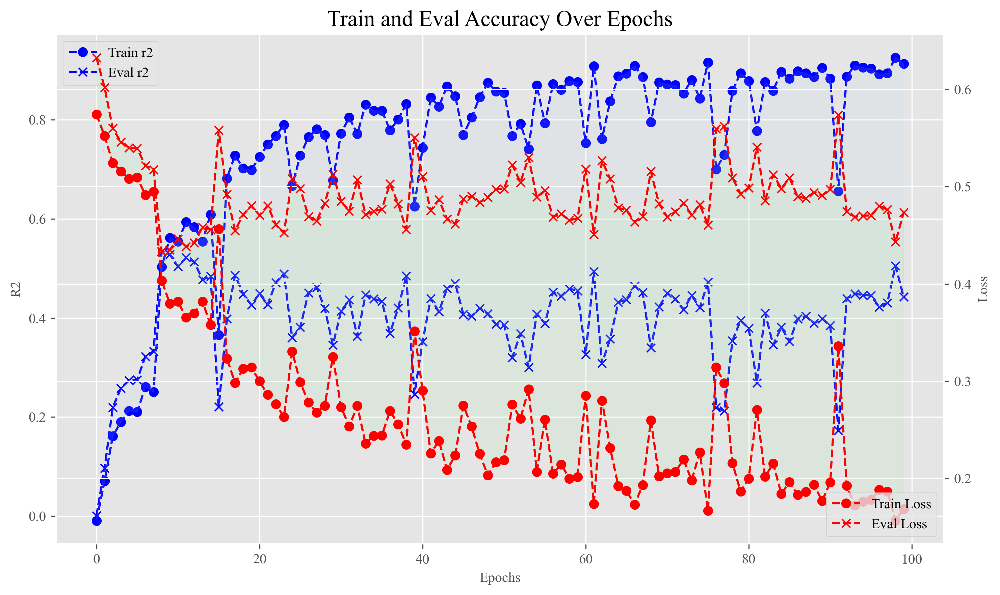

[I 2024-05-05 21:30:24,429] Trial 22 finished with value: 0.4333854019641876 and parameters: {'num_blocks': 8, 'dropout': 0.17819224466825936, 'purns': 0.12783729078044026, 'lr': 0.00026641822046202107}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5723078846931458 eval_loss:0.6227746605873108 trainr2 -0.0023061057365045823 evalr2 0.03198494808912744
train_loss0.5386435389518738 eval_loss:0.5862439274787903 trainr2 0.1151285908855817 evalr2 0.14217044801135048
train_loss0.5356536507606506 eval_loss:0.5762469172477722 trainr2 0.12514891593662225 evalr2 0.1731127938787349
train_loss0.5326431393623352 eval_loss:0.5690175294876099 trainr2 0.13594948439206822 evalr2 0.19409416222871223
train_loss0.5305026769638062 eval_loss:0.5667845606803894 trainr2 0.14157046986936395 evalr2 0.20041812884800347
train_loss0.530376136302948 eval_loss:0.5655006170272827 trainr2 0.14340628729435456 evalr2 0.20408978733226846
train_loss0.5414629578590393 eval_loss:0.5720636248588562 trainr2 0.10340313842201654 evalr2 0.18568839117860858
train_loss0.4912642538547516 eval_loss:0.5243366360664368 trainr2 0.26122260170405476 evalr2 0.31511805003945337
train_loss0.5226277112960815 eval_loss:0.5485140085220337 trainr2 0.16532601806880887 evalr2 0.2

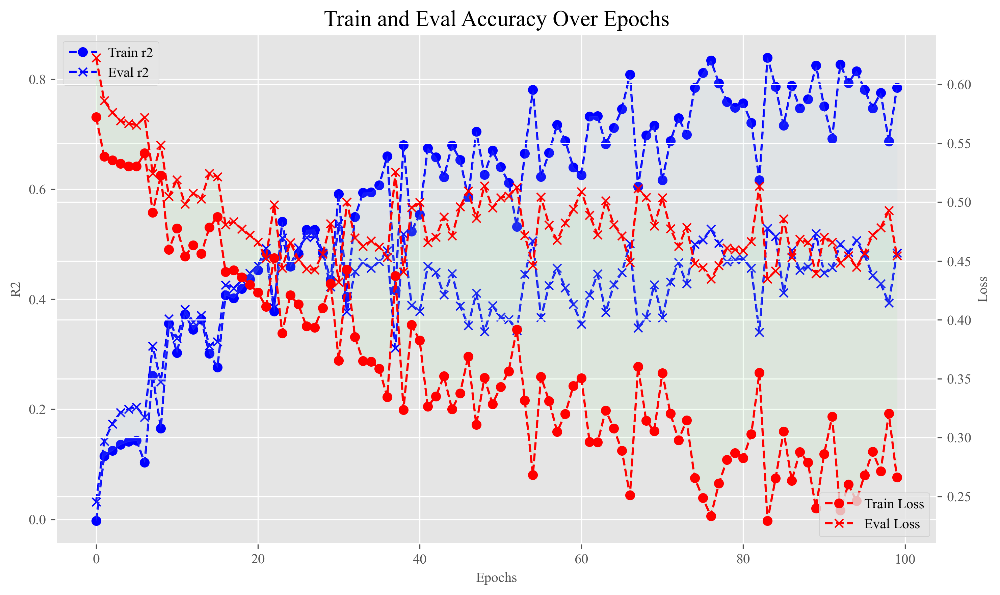

[I 2024-05-05 21:40:37,428] Trial 23 finished with value: 0.43217790126800537 and parameters: {'num_blocks': 7, 'dropout': 0.19028819648871878, 'purns': 0.15202895080190143, 'lr': 7.573311286929484e-05}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.8012236952781677 eval_loss:0.8519373536109924 trainr2 -0.9639191023440279 evalr2 -0.8188486883394899
train_loss0.542320728302002 eval_loss:0.591961681842804 trainr2 0.10320162740100414 evalr2 0.12580437068156025
train_loss0.5347418785095215 eval_loss:0.5758236646652222 trainr2 0.12802026614126583 evalr2 0.17456970048103915
train_loss0.5385862588882446 eval_loss:0.5737876892089844 trainr2 0.1164466874279313 evalr2 0.1808938263872394
train_loss0.5305550694465637 eval_loss:0.5657364726066589 trainr2 0.14131227186164252 evalr2 0.20372917496627063
train_loss0.5339618921279907 eval_loss:0.5674514770507812 trainr2 0.13206862758605997 evalr2 0.19895557117119345
train_loss0.5393786430358887 eval_loss:0.5675402879714966 trainr2 0.11047773332323108 evalr2 0.19872919467011152
train_loss0.5034016966819763 eval_loss:0.5318894386291504 trainr2 0.22395997316990457 evalr2 0.2966315496069657
train_loss0.526540994644165 eval_loss:0.5472227334976196 trainr2 0.15315638469578796 evalr2 0.2549723

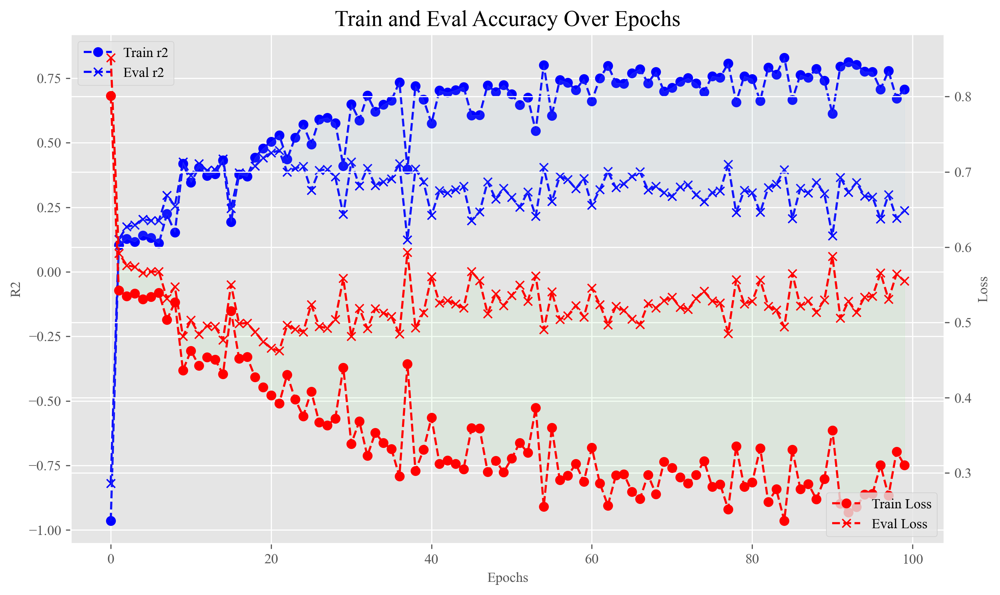

[I 2024-05-05 21:49:44,398] Trial 24 finished with value: 0.46207329630851746 and parameters: {'num_blocks': 6, 'dropout': 0.2108189127954873, 'purns': 0.1259053761027574, 'lr': 0.0001411858551356697}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5731297135353088 eval_loss:0.6278043985366821 trainr2 -0.0026417849915165714 evalr2 0.008001656572640514
train_loss0.56008380651474 eval_loss:0.616205632686615 trainr2 0.04347754002062032 evalr2 0.05191840751639498
train_loss0.5446614623069763 eval_loss:0.5948910117149353 trainr2 0.09532389356469839 evalr2 0.11701553939123643
train_loss0.5432328581809998 eval_loss:0.5894629955291748 trainr2 0.10123844231419621 evalr2 0.13340050550951021
train_loss0.5436004996299744 eval_loss:0.5894917845726013 trainr2 0.09866800561112854 evalr2 0.13338602047088477
train_loss0.5417002439498901 eval_loss:0.5864901542663574 trainr2 0.10664838970737811 evalr2 0.14221202907667785
train_loss0.55816251039505 eval_loss:0.5978593826293945 trainr2 0.04753642703579275 evalr2 0.10874330331127069
train_loss0.4950166642665863 eval_loss:0.5312918424606323 trainr2 0.2502014824297961 evalr2 0.2956103127489259
train_loss0.5641951560974121 eval_loss:0.5907889008522034 trainr2 0.026994212460986988 evalr2 0.128

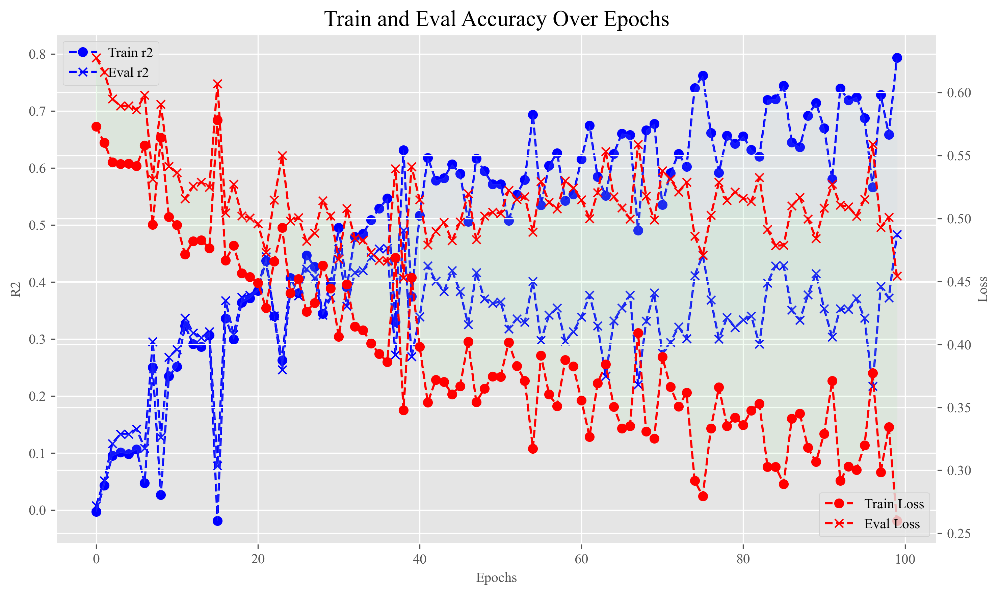

[I 2024-05-05 22:01:17,622] Trial 25 finished with value: 0.4528271555900574 and parameters: {'num_blocks': 8, 'dropout': 0.22508138662567856, 'purns': 0.17837736412544752, 'lr': 6.155852894851186e-05}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5716163516044617 eval_loss:0.6196914315223694 trainr2 0.002488808196071113 evalr2 0.03474534015021058
train_loss0.5376119017601013 eval_loss:0.5849909782409668 trainr2 0.11889309904637257 evalr2 0.14651092372584407
train_loss0.5383137464523315 eval_loss:0.5668151378631592 trainr2 0.11655232661591886 evalr2 0.20049801355563213
train_loss0.5216719508171082 eval_loss:0.5464411377906799 trainr2 0.1711119448347853 evalr2 0.25678475049329186
train_loss0.5163806080818176 eval_loss:0.5417298674583435 trainr2 0.18640195390184822 evalr2 0.26948323278072295
train_loss0.5172146558761597 eval_loss:0.5406906008720398 trainr2 0.18577922026580906 evalr2 0.27230119418699794
train_loss0.5032746195793152 eval_loss:0.5226861834526062 trainr2 0.22505042247956053 evalr2 0.3197170154824325
train_loss0.5209356546401978 eval_loss:0.5480660796165466 trainr2 0.1694382342544175 evalr2 0.2518910179479341
train_loss0.4405907094478607 eval_loss:0.48661813139915466 trainr2 0.4072878665386358 evalr2 0.4128

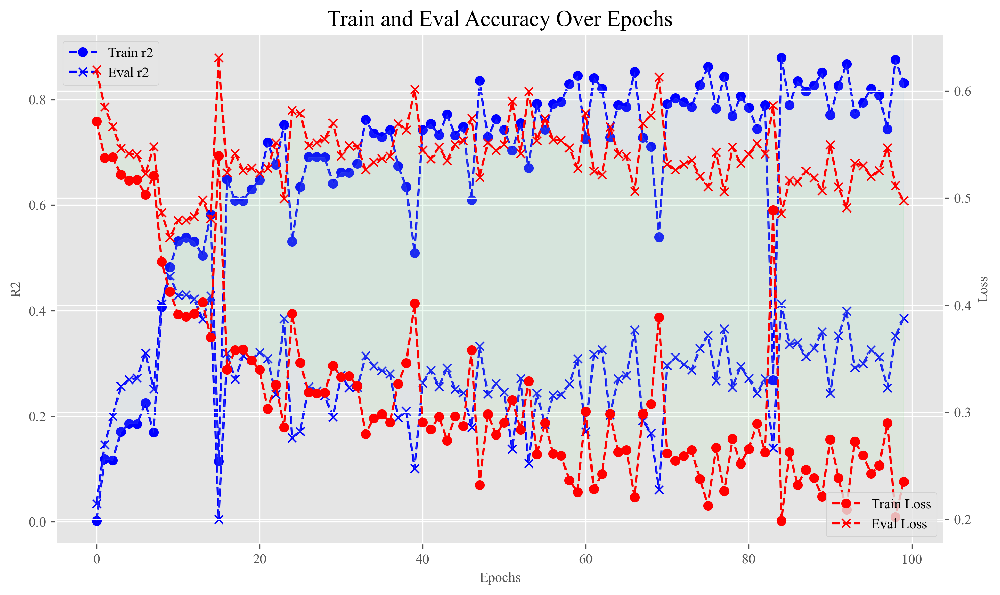

[I 2024-05-05 22:11:35,472] Trial 26 finished with value: 0.4631092846393585 and parameters: {'num_blocks': 7, 'dropout': 0.23969927737915217, 'purns': 0.14029439078403677, 'lr': 0.0003566395440569781}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.7169418931007385 eval_loss:0.7730375528335571 trainr2 -0.5729416142383394 evalr2 -0.4944236852267354
train_loss0.5411623120307922 eval_loss:0.5901582837104797 trainr2 0.10697539306320913 evalr2 0.12975348558254562
train_loss0.546038031578064 eval_loss:0.5878308415412903 trainr2 0.09069899969397499 evalr2 0.13915436119593128
train_loss0.5356976985931396 eval_loss:0.572115421295166 trainr2 0.12607870798505505 evalr2 0.18481735725473614
train_loss0.5375810265541077 eval_loss:0.5734714865684509 trainr2 0.11845704781156885 evalr2 0.1810248475641828
train_loss0.5388927459716797 eval_loss:0.5732941627502441 trainr2 0.11600700352346838 evalr2 0.18157856718487564
train_loss0.5482892990112305 eval_loss:0.5764645338058472 trainr2 0.08069467576815981 evalr2 0.17244788790374121
train_loss0.4812936782836914 eval_loss:0.5124079585075378 trainr2 0.2914286355038431 evalr2 0.34527446937063966
train_loss0.5410597920417786 eval_loss:0.5695093870162964 trainr2 0.10580290263862457 evalr2 0.19070

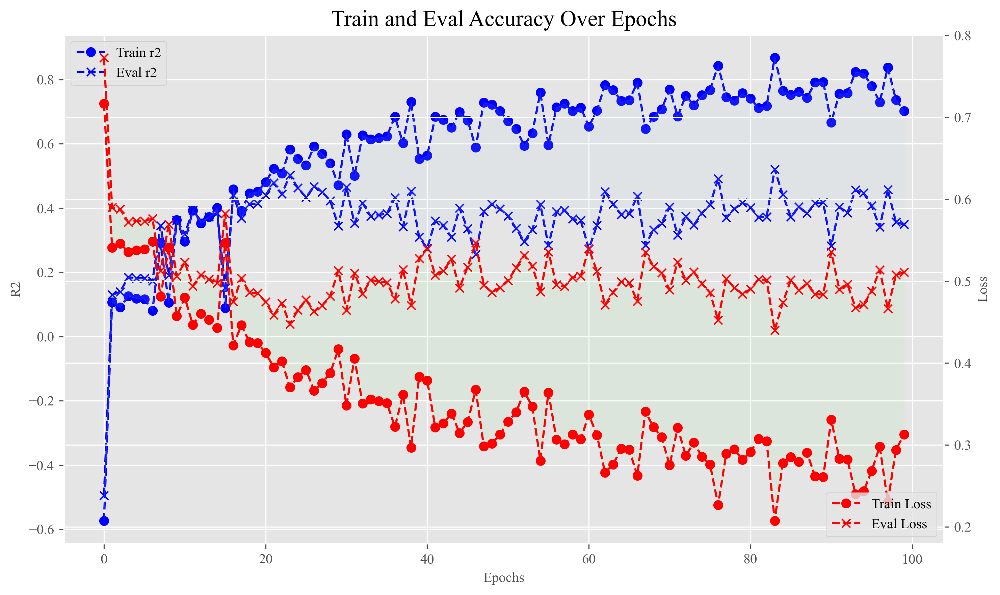

[I 2024-05-05 22:20:42,037] Trial 27 finished with value: 0.4401242434978485 and parameters: {'num_blocks': 6, 'dropout': 0.20183952743456204, 'purns': 0.12174866372390458, 'lr': 0.00011680969589609849}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.6276108622550964 eval_loss:0.686561107635498 trainr2 -0.20569448805178192 evalr2 -0.17603497517385613
train_loss0.5320600271224976 eval_loss:0.5683382749557495 trainr2 0.13735267314210742 evalr2 0.1963040271890829
train_loss0.49623697996139526 eval_loss:0.530767023563385 trainr2 0.24974404428399022 evalr2 0.29940243316724424
train_loss0.4580266773700714 eval_loss:0.49311572313308716 trainr2 0.36141935493532673 evalr2 0.3958081492640796
train_loss0.4667307436466217 eval_loss:0.49527955055236816 trainr2 0.33540490199149187 evalr2 0.39162291983494424
train_loss0.4631052315235138 eval_loss:0.49209505319595337 trainr2 0.34678561515164963 evalr2 0.3999587242591396
train_loss0.4560427963733673 eval_loss:0.511833667755127 trainr2 0.363748375740815 evalr2 0.3510033572811676
train_loss0.40205907821655273 eval_loss:0.4817570149898529 trainr2 0.5048669436471178 evalr2 0.42562505330089806
train_loss0.34565469622612 eval_loss:0.4661378860473633 trainr2 0.6349799843194801 evalr2 0.4610020

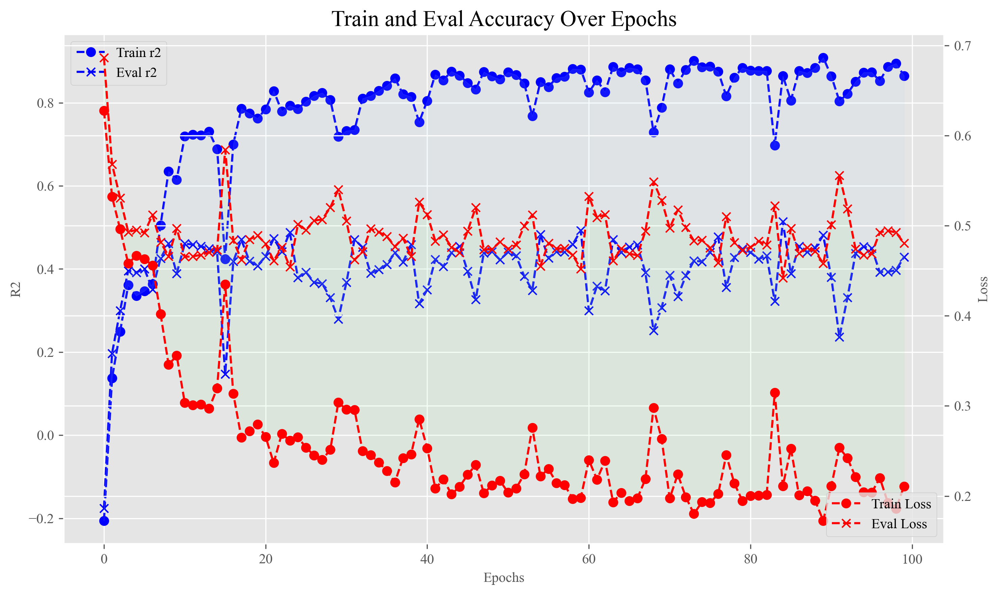

[I 2024-05-05 22:32:28,822] Trial 28 finished with value: 0.44199204444885254 and parameters: {'num_blocks': 8, 'dropout': 0.18570310566224468, 'purns': 0.1597824485601106, 'lr': 0.0005705393053613907}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5780278444290161 eval_loss:0.6271915435791016 trainr2 -0.019816948501547138 evalr2 0.010454526434692468
train_loss0.5403038263320923 eval_loss:0.5901679396629333 trainr2 0.10998747601613434 evalr2 0.130195871121898
train_loss0.5232686400413513 eval_loss:0.5614542365074158 trainr2 0.16527098913003402 evalr2 0.21442533779216233
train_loss0.5300604104995728 eval_loss:0.5590729117393494 trainr2 0.14392061954430135 evalr2 0.22160025562420194
train_loss0.5196672677993774 eval_loss:0.5494269728660583 trainr2 0.17608174357294937 evalr2 0.24814860321823895
train_loss0.523134171962738 eval_loss:0.5508725047111511 trainr2 0.1669233853785298 evalr2 0.24426067707545718
train_loss0.5101696252822876 eval_loss:0.5346753001213074 trainr2 0.20391517167959106 evalr2 0.2879335500815293
train_loss0.5297723412513733 eval_loss:0.5487110018730164 trainr2 0.14097516314056135 evalr2 0.24902874862455493
train_loss0.4422711133956909 eval_loss:0.46973007917404175 trainr2 0.4028308071072786 evalr2 0.452

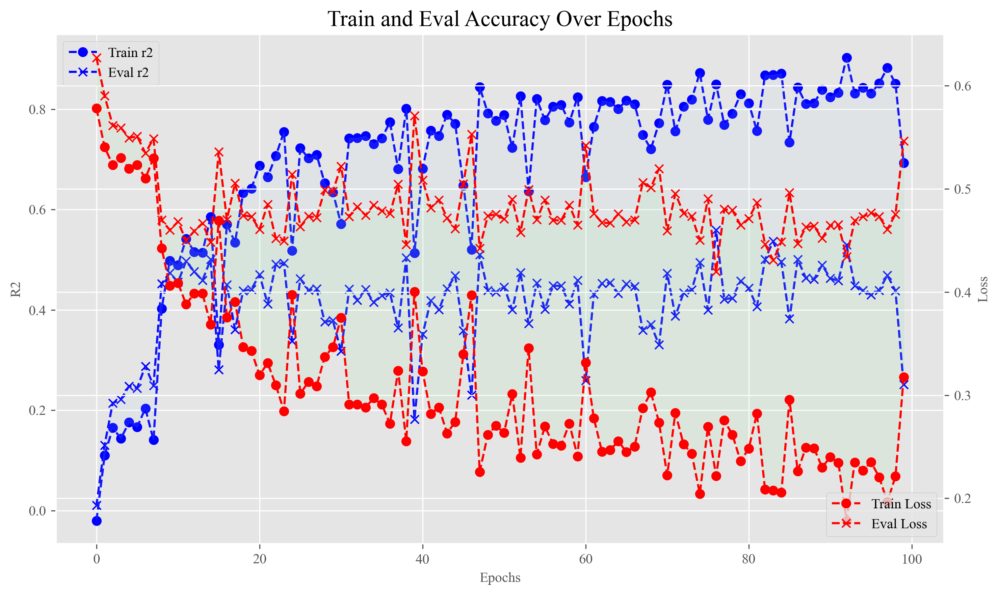

[I 2024-05-05 22:42:47,423] Trial 29 finished with value: 0.4198265075683594 and parameters: {'num_blocks': 7, 'dropout': 0.21171403382645382, 'purns': 0.18529128137456025, 'lr': 0.00024616477797909623}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.6844547986984253 eval_loss:0.7461819648742676 trainr2 -0.4337483645822613 evalr2 -0.3909757289486131
train_loss0.5541747808456421 eval_loss:0.6077276468276978 trainr2 0.06374370626163828 evalr2 0.07852689291633541
train_loss0.5336090326309204 eval_loss:0.5609093904495239 trainr2 0.13222698914601305 evalr2 0.21745747603103716
train_loss0.5015996098518372 eval_loss:0.5322645306587219 trainr2 0.23387570282833126 evalr2 0.29576368868772607
train_loss0.506660521030426 eval_loss:0.5338418483734131 trainr2 0.2166779652028542 evalr2 0.2918975537667752
train_loss0.5047513842582703 eval_loss:0.5290395021438599 trainr2 0.22443243430521254 evalr2 0.304728318473244
train_loss0.48725053668022156 eval_loss:0.5377957224845886 trainr2 0.27374129228584143 evalr2 0.28180766472471197
train_loss0.5090703368186951 eval_loss:0.555785059928894 trainr2 0.20735695795443687 evalr2 0.2293344705186443
train_loss0.3768571615219116 eval_loss:0.4601736068725586 trainr2 0.5659901639637666 evalr2 0.47753804

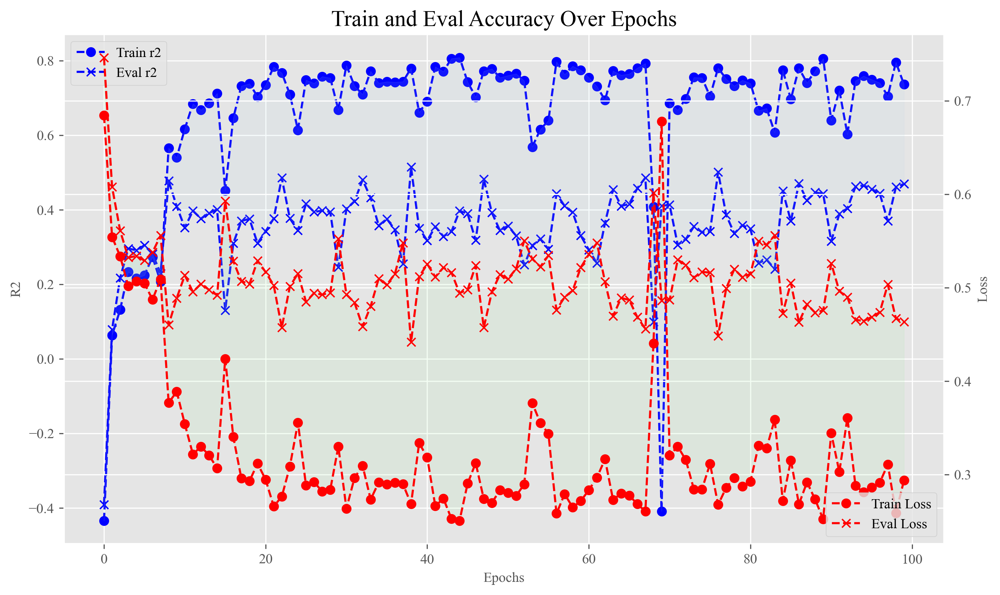

[I 2024-05-05 22:58:24,387] Trial 30 finished with value: 0.4418482184410095 and parameters: {'num_blocks': 8, 'dropout': 0.2118533335576927, 'purns': 0.19031720813412065, 'lr': 0.0008207178884606318}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5899327993392944 eval_loss:0.6357670426368713 trainr2 -0.06181445244310324 evalr2 -0.018640138542106888
train_loss0.5387182235717773 eval_loss:0.587303102016449 trainr2 0.11521081300122671 evalr2 0.13801948151440768
train_loss0.5343403816223145 eval_loss:0.5722732543945312 trainr2 0.1293809500504206 evalr2 0.18401288236830693
train_loss0.5269291996955872 eval_loss:0.5590746402740479 trainr2 0.15423312410052492 evalr2 0.22131484407226043
train_loss0.5223991274833679 eval_loss:0.5546387434005737 trainr2 0.16739828211129248 evalr2 0.23353339407423745
train_loss0.5231794118881226 eval_loss:0.5541272759437561 trainr2 0.1666264748996935 evalr2 0.23498535629290584
train_loss0.5121377110481262 eval_loss:0.5411632657051086 trainr2 0.19769220242668428 evalr2 0.27023955881023165
train_loss0.4953727722167969 eval_loss:0.5196657180786133 trainr2 0.24859743711407944 evalr2 0.3275012522970552
train_loss0.44920921325683594 eval_loss:0.4799978733062744 trainr2 0.3837710860827924 evalr2 0.42

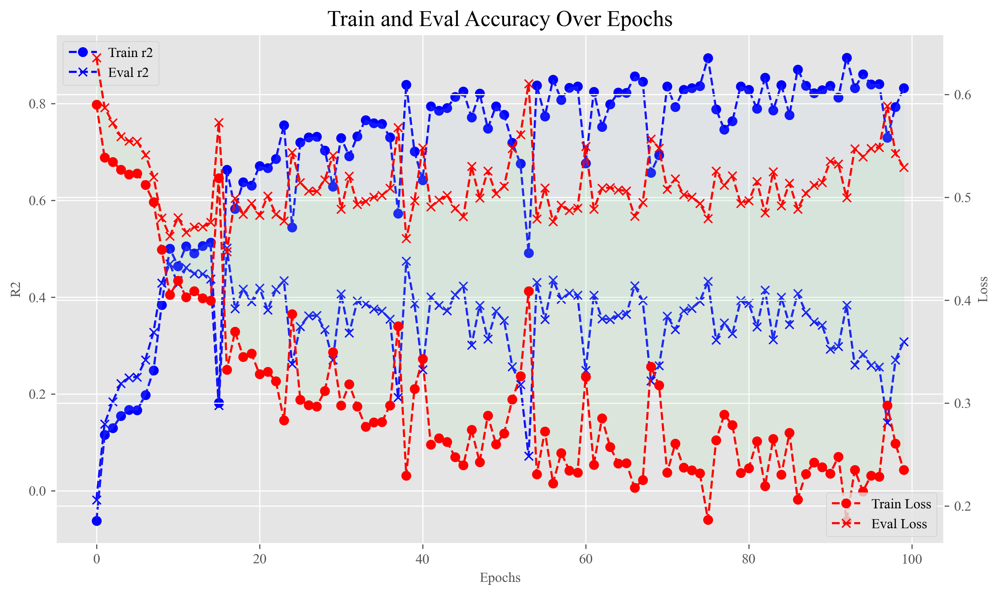

[I 2024-05-05 23:10:58,503] Trial 31 finished with value: 0.4471924901008606 and parameters: {'num_blocks': 7, 'dropout': 0.204216431444467, 'purns': 0.15001802138154172, 'lr': 0.0002513864304300395}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.58521568775177 eval_loss:0.6333419680595398 trainr2 -0.0450768790956142 evalr2 -0.009850082275597583
train_loss0.536541223526001 eval_loss:0.587242841720581 trainr2 0.1222673020782642 evalr2 0.139305898460939
train_loss0.5281734466552734 eval_loss:0.5688380002975464 trainr2 0.1494660899827831 evalr2 0.1941132886245157
train_loss0.5298718810081482 eval_loss:0.5640563368797302 trainr2 0.14489230489434846 evalr2 0.2078908021231859
train_loss0.5202386975288391 eval_loss:0.5552471280097961 trainr2 0.1742027147874713 evalr2 0.23231081403868192
train_loss0.5235787630081177 eval_loss:0.5567740201950073 trainr2 0.16547759566634057 evalr2 0.22817374117672895
train_loss0.5152487754821777 eval_loss:0.5453672409057617 trainr2 0.18800368053087924 evalr2 0.25943403936301435
train_loss0.4927957057952881 eval_loss:0.5210326910018921 trainr2 0.25639307433261693 evalr2 0.32461698888951895
train_loss0.4616084098815918 eval_loss:0.48776108026504517 trainr2 0.349370610972905 evalr2 0.41020385693

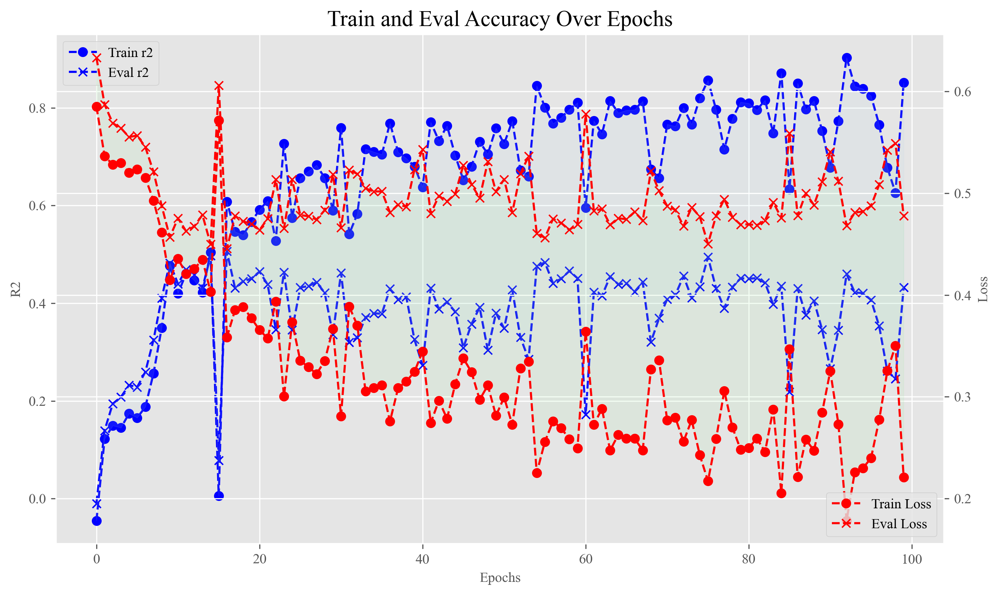

[I 2024-05-05 23:25:37,330] Trial 32 finished with value: 0.44565272331237793 and parameters: {'num_blocks': 7, 'dropout': 0.21630236405129, 'purns': 0.13733597240705378, 'lr': 0.0001884533339849699}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.6028562784194946 eval_loss:0.6623538732528687 trainr2 -0.11243209605646887 evalr2 -0.09525567261198709
train_loss0.5582600831985474 eval_loss:0.6107321977615356 trainr2 0.04991464116364741 evalr2 0.06942238360053798
train_loss0.5352063775062561 eval_loss:0.5785356163978577 trainr2 0.1267227064847728 evalr2 0.16560177880059157
train_loss0.5379281044006348 eval_loss:0.5736410617828369 trainr2 0.11853554936587363 evalr2 0.18042416082746326
train_loss0.5293442010879517 eval_loss:0.5648993849754333 trainr2 0.14538327420525587 evalr2 0.2051560897349245
train_loss0.5305100679397583 eval_loss:0.5640905499458313 trainr2 0.14310879503826435 evalr2 0.2075411737698204
train_loss0.5322660803794861 eval_loss:0.5572203993797302 trainr2 0.13347306383502333 evalr2 0.22704473699158578
train_loss0.49984514713287354 eval_loss:0.5224674940109253 trainr2 0.23520909365082632 evalr2 0.3207664272057478
train_loss0.4993225336074829 eval_loss:0.5179803371429443 trainr2 0.2385361486560469 evalr2 0.332

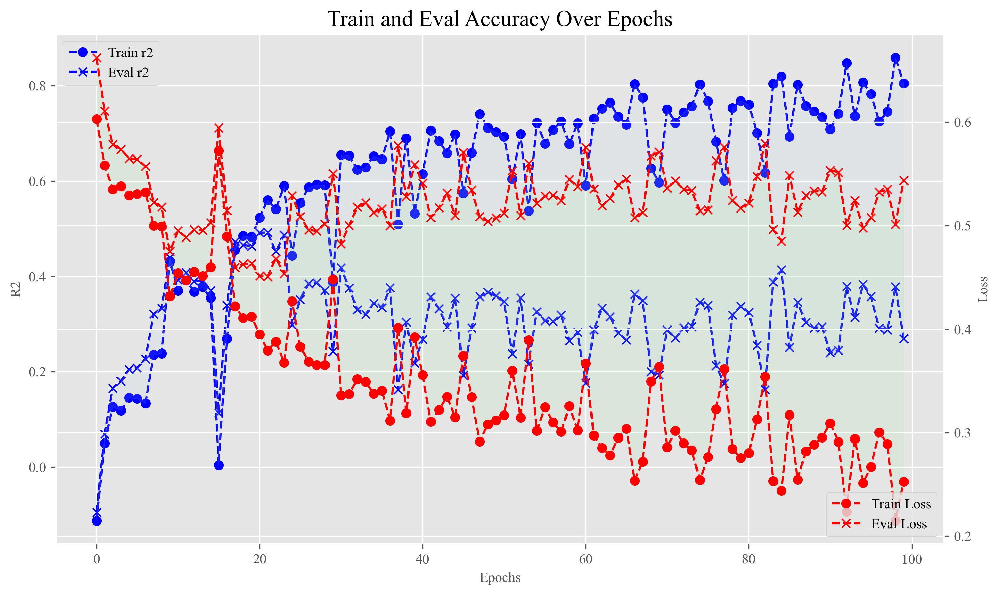

[I 2024-05-05 23:49:41,436] Trial 33 finished with value: 0.45086127519607544 and parameters: {'num_blocks': 8, 'dropout': 0.24248520370862747, 'purns': 0.1601129019987844, 'lr': 0.00015740943463311637}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.557466447353363 eval_loss:0.6115720868110657 trainr2 0.04917509293188238 evalr2 0.06685415286022967
train_loss0.5621837377548218 eval_loss:0.6001867651939392 trainr2 0.03691210048703386 evalr2 0.10365277647689286
train_loss0.532456636428833 eval_loss:0.5584831833839417 trainr2 0.13571730263164006 evalr2 0.22424255048371733
train_loss0.5103939175605774 eval_loss:0.538118839263916 trainr2 0.20651070363475432 evalr2 0.27964075255942467
train_loss0.5039278864860535 eval_loss:0.5325763821601868 trainr2 0.22537337330473195 evalr2 0.29437189540419817
train_loss0.5057721734046936 eval_loss:0.5330134034156799 trainr2 0.22127974648839277 evalr2 0.2932067574000208
train_loss0.48875802755355835 eval_loss:0.5177063345909119 trainr2 0.2687265069943038 evalr2 0.3331178411165321
train_loss0.49505940079689026 eval_loss:0.5498009920120239 trainr2 0.2496382359837902 evalr2 0.24671178265536442
train_loss0.3908091187477112 eval_loss:0.46130648255348206 trainr2 0.5332561973594563 evalr2 0.475050

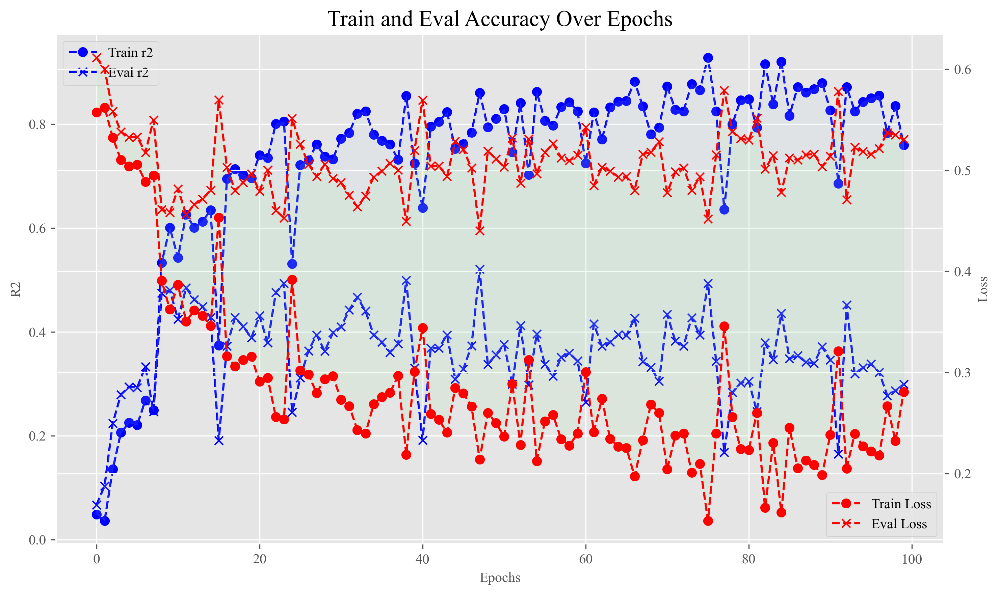

[I 2024-05-05 23:57:56,832] Trial 34 finished with value: 0.4402429163455963 and parameters: {'num_blocks': 5, 'dropout': 0.17870874457620678, 'purns': 0.18603800095623585, 'lr': 0.00036150902123406484}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss1.6932872533798218 eval_loss:1.7014411687850952 trainr2 -7.7546554774844765 evalr2 -6.333857585348213
train_loss0.6592289209365845 eval_loss:0.7055708765983582 trainr2 -0.3248714163919295 evalr2 -0.24296874511635824
train_loss0.6379213333129883 eval_loss:0.6817123293876648 trainr2 -0.24145320630053013 evalr2 -0.1591435502563321
train_loss0.6462169289588928 eval_loss:0.6869201064109802 trainr2 -0.27187918205931405 evalr2 -0.17700642811405531
train_loss0.6402588486671448 eval_loss:0.6813526153564453 trainr2 -0.2500784823063178 evalr2 -0.15778867222556148
train_loss0.6445432305335999 eval_loss:0.6841397881507874 trainr2 -0.2632969438268544 evalr2 -0.16735667197916726
train_loss0.6317518353462219 eval_loss:0.6716393828392029 trainr2 -0.22014726587140343 evalr2 -0.12454426792745643
train_loss0.6188375949859619 eval_loss:0.6545475125312805 trainr2 -0.1725770256445731 evalr2 -0.06709440245689446
train_loss0.6196359992027283 eval_loss:0.6518493890762329 trainr2 -0.17357373186931468 e

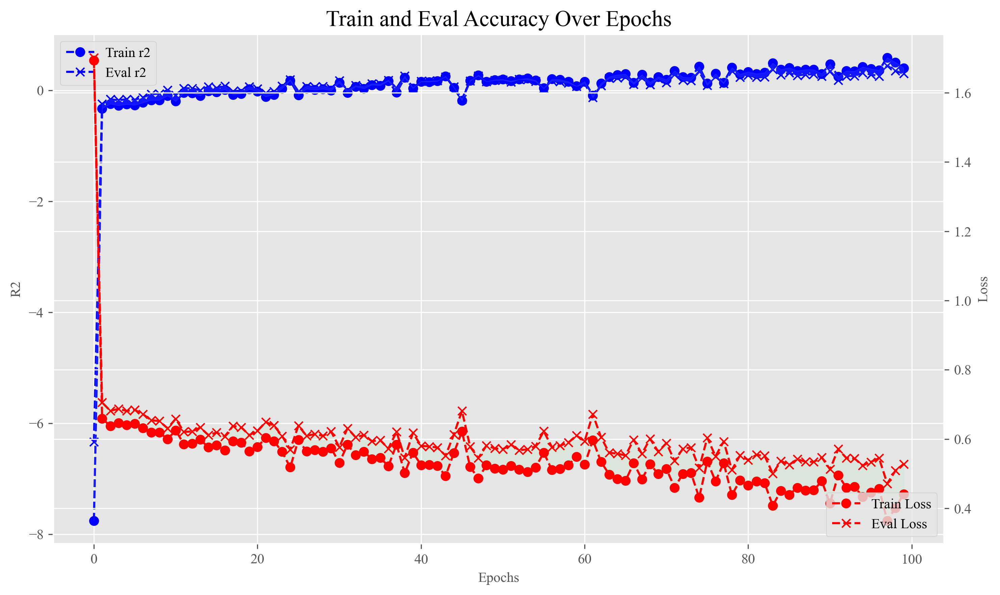

[I 2024-05-06 00:11:29,537] Trial 35 finished with value: 0.47140902280807495 and parameters: {'num_blocks': 6, 'dropout': 0.196522459310448, 'purns': 0.17250340511121426, 'lr': 1.7802763484301988e-05}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.7612832188606262 eval_loss:0.817978024482727 trainr2 -0.7734248950320808 evalr2 -0.6748781144544598
train_loss0.5589888691902161 eval_loss:0.6137057542800903 trainr2 0.047436354193266195 evalr2 0.06038595440677408
train_loss0.5339549779891968 eval_loss:0.5826473236083984 trainr2 0.13067534938561953 evalr2 0.15346952535335623
train_loss0.5338187217712402 eval_loss:0.5782511234283447 trainr2 0.1321336111876077 evalr2 0.16645413927305186
train_loss0.5263447761535645 eval_loss:0.5710458755493164 trainr2 0.15494746528153636 evalr2 0.18705481523074863
train_loss0.5287696719169617 eval_loss:0.5720660090446472 trainr2 0.14883750714756083 evalr2 0.18419247995105803
train_loss0.51998370885849 eval_loss:0.5613518953323364 trainr2 0.17291605255866183 evalr2 0.21442628612399406
train_loss0.5007332563400269 eval_loss:0.5421237945556641 trainr2 0.23229286933586113 evalr2 0.26745359015040815
train_loss0.5365206003189087 eval_loss:0.5756880640983582 trainr2 0.12064363848101523 evalr2 0.1723

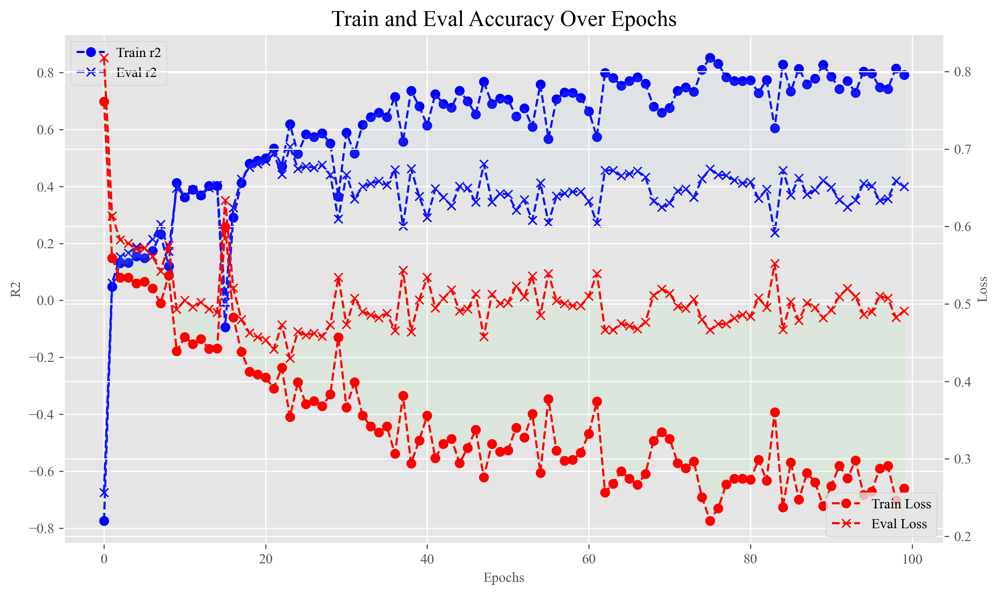

[I 2024-05-06 00:38:15,209] Trial 36 finished with value: 0.4297100901603699 and parameters: {'num_blocks': 7, 'dropout': 0.20811271126036018, 'purns': 0.15703507021563629, 'lr': 0.00011571081449532912}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5606535077095032 eval_loss:0.6161112189292908 trainr2 0.03954862496658773 evalr2 0.04872731764345406
train_loss0.5491511821746826 eval_loss:0.602126955986023 trainr2 0.08066919720927379 evalr2 0.09524249892855008
train_loss0.5343158841133118 eval_loss:0.577544093132019 trainr2 0.12955656213791034 evalr2 0.16934286903550222
train_loss0.5343625545501709 eval_loss:0.5681946277618408 trainr2 0.13035374856530713 evalr2 0.19682506843840897
train_loss0.5268542170524597 eval_loss:0.5602304339408875 trainr2 0.15337170717890414 evalr2 0.2192228535484808
train_loss0.5303614139556885 eval_loss:0.5611168146133423 trainr2 0.14376552374381257 evalr2 0.21685770010834937
train_loss0.5258708000183105 eval_loss:0.5478092432022095 trainr2 0.15419801790020016 evalr2 0.25372571723629733
train_loss0.4974076747894287 eval_loss:0.5201935172080994 trainr2 0.24252734571022583 evalr2 0.32756408353038124
train_loss0.4682393968105316 eval_loss:0.5010331869125366 trainr2 0.3305425769571141 evalr2 0.37822

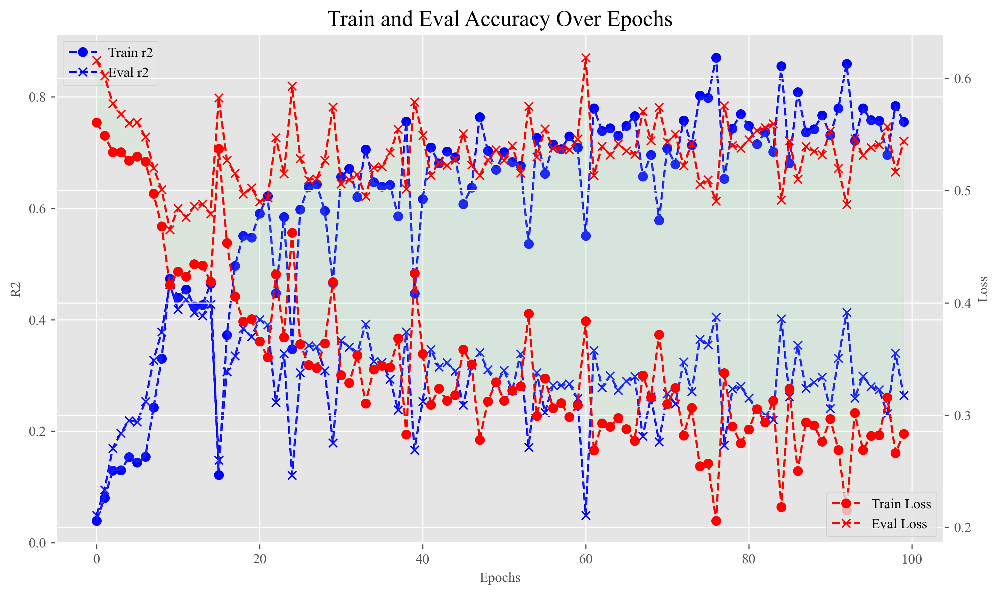

[I 2024-05-06 01:33:34,555] Trial 37 finished with value: 0.4652542471885681 and parameters: {'num_blocks': 8, 'dropout': 0.2593740895138084, 'purns': 0.1970958865691506, 'lr': 0.00022240911671700145}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5550183057785034 eval_loss:0.6074418425559998 trainr2 0.05797974007879181 evalr2 0.07663281757105378
train_loss0.5439421534538269 eval_loss:0.5934080481529236 trainr2 0.09772849904500114 evalr2 0.12127544580074223
train_loss0.5302491784095764 eval_loss:0.5722825527191162 trainr2 0.14281747939228373 evalr2 0.18355238264255958
train_loss0.5226807594299316 eval_loss:0.5610069632530212 trainr2 0.16777173784846944 evalr2 0.21552046451678375
train_loss0.5229713320732117 eval_loss:0.5610207915306091 trainr2 0.16549114427353362 evalr2 0.21555471163672835
train_loss0.5255534052848816 eval_loss:0.5620879530906677 trainr2 0.15910890978954417 evalr2 0.21265343099704148
train_loss0.535086989402771 eval_loss:0.5665899515151978 trainr2 0.12420072104017532 evalr2 0.20003813226500755
train_loss0.48267051577568054 eval_loss:0.52289879322052 trainr2 0.2878166615905754 evalr2 0.3154446331499493
train_loss0.5220566391944885 eval_loss:0.5510913729667664 trainr2 0.16741006817282822 evalr2 0.24257

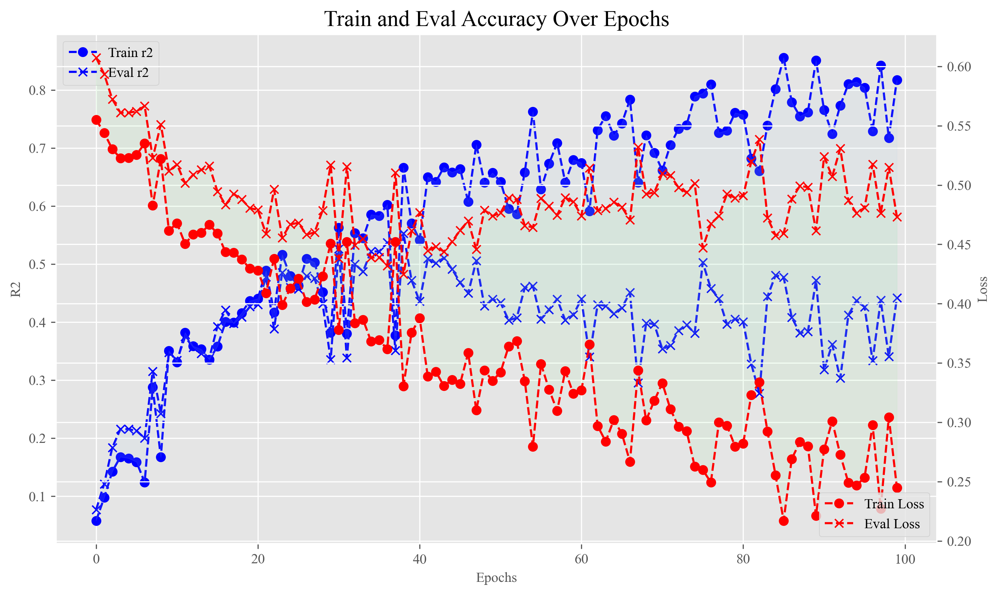

[I 2024-05-06 02:24:38,175] Trial 38 finished with value: 0.4247783422470093 and parameters: {'num_blocks': 7, 'dropout': 0.17286767700341965, 'purns': 0.21356126546285847, 'lr': 5.9649627452702294e-05}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.7008198499679565 eval_loss:0.7532907128334045 trainr2 -0.5031441950648492 evalr2 -0.41907199753157753
train_loss0.5420506596565247 eval_loss:0.5939224362373352 trainr2 0.10394785545095597 evalr2 0.1192460972919972
train_loss0.5519988536834717 eval_loss:0.5986633896827698 trainr2 0.07068411232875893 evalr2 0.10731335347589288
train_loss0.5438116788864136 eval_loss:0.5871953964233398 trainr2 0.09929245708854662 evalr2 0.14134674611996445
train_loss0.5449057817459106 eval_loss:0.5880842208862305 trainr2 0.09442841817125003 evalr2 0.13878223594208805
train_loss0.5504889488220215 eval_loss:0.5922890901565552 trainr2 0.07744329366050473 evalr2 0.12646174251176212
train_loss0.54975825548172 eval_loss:0.5895888209342957 trainr2 0.07565354504811783 evalr2 0.13453956518988697
train_loss0.5014914870262146 eval_loss:0.5417612195014954 trainr2 0.23019947446402733 evalr2 0.26923453284025245
train_loss0.539505660533905 eval_loss:0.5726516246795654 trainr2 0.11011594530570346 evalr2 0.1829

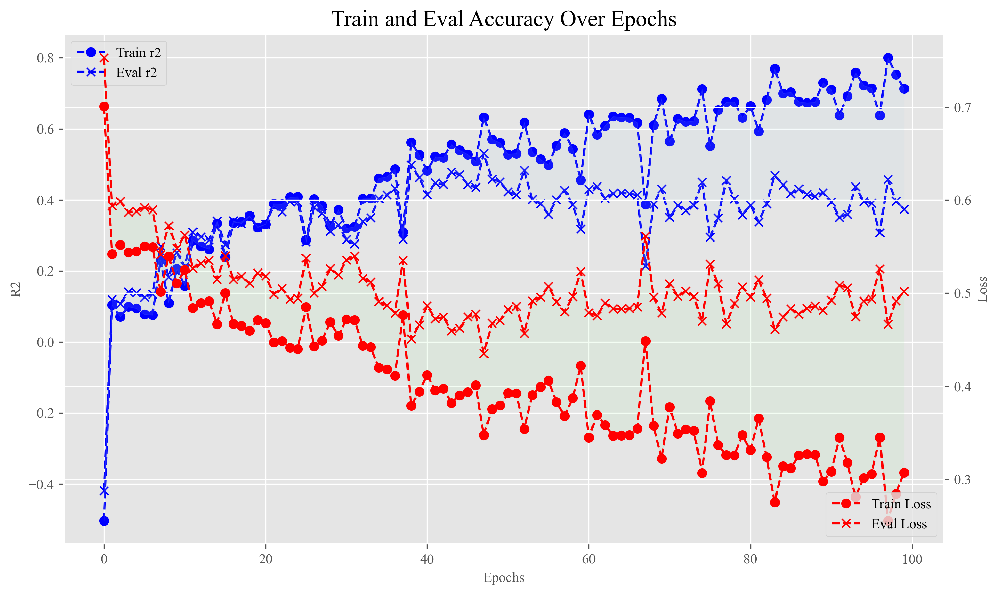

[I 2024-05-06 03:12:50,813] Trial 39 finished with value: 0.4350959360599518 and parameters: {'num_blocks': 6, 'dropout': 0.15476790799851364, 'purns': 0.21729839037997334, 'lr': 3.47667864833984e-05}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.7690619826316833 eval_loss:0.8210388422012329 trainr2 -0.8098867826632292 evalr2 -0.688454623423356
train_loss0.5343649983406067 eval_loss:0.5860157608985901 trainr2 0.12907860480328426 evalr2 0.14094947853850026
train_loss0.5258849859237671 eval_loss:0.5720546245574951 trainr2 0.156816781154399 evalr2 0.18376301769427061
train_loss0.5238186717033386 eval_loss:0.5662484765052795 trainr2 0.16438187770048673 evalr2 0.2006639642201643
train_loss0.5223004817962646 eval_loss:0.5647407174110413 trainr2 0.16756156508617803 evalr2 0.2049497797085954
train_loss0.5202043056488037 eval_loss:0.5617539286613464 trainr2 0.17597346722041252 evalr2 0.21332325449932432
train_loss0.5239192247390747 eval_loss:0.5625590682029724 trainr2 0.16036347926454364 evalr2 0.21139208615585614
train_loss0.4873465299606323 eval_loss:0.526957094669342 trainr2 0.27286797864091983 evalr2 0.30785514576247774
train_loss0.5080961585044861 eval_loss:0.5465306043624878 trainr2 0.21113957749001822 evalr2 0.2553882

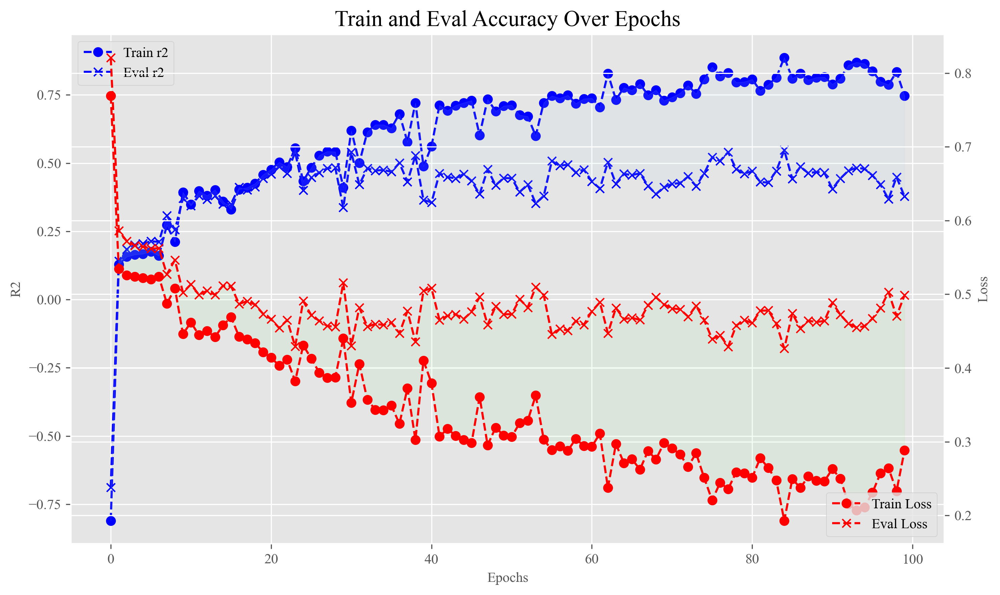

[I 2024-05-06 04:55:00,052] Trial 40 finished with value: 0.4264710545539856 and parameters: {'num_blocks': 8, 'dropout': 0.1694068716712046, 'purns': 0.21371349096020714, 'lr': 6.28175332950791e-05}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.7891987562179565 eval_loss:0.8409030437469482 trainr2 -0.9054987703141351 evalr2 -0.7715922399441484
train_loss0.5403582453727722 eval_loss:0.5925863981246948 trainr2 0.10958287798664801 evalr2 0.12206278659016168
train_loss0.5330320000648499 eval_loss:0.5796690583229065 trainr2 0.13387421437707359 evalr2 0.1621936132699111
train_loss0.5305661559104919 eval_loss:0.5732083916664124 trainr2 0.14260811096116588 evalr2 0.18127439937555412
train_loss0.5301778316497803 eval_loss:0.572474479675293 trainr2 0.1426775446534564 evalr2 0.18346197556930144
train_loss0.530276894569397 eval_loss:0.5714266896247864 trainr2 0.14378198788031582 evalr2 0.18651686953361457
train_loss0.5355692505836487 eval_loss:0.5720534324645996 trainr2 0.12284413713274733 evalr2 0.18512219392751728
train_loss0.4895818829536438 eval_loss:0.5266121029853821 trainr2 0.2667963688924908 evalr2 0.307801212263363
train_loss0.5371201634407043 eval_loss:0.5610863566398621 trainr2 0.11839278800098196 evalr2 0.21510882

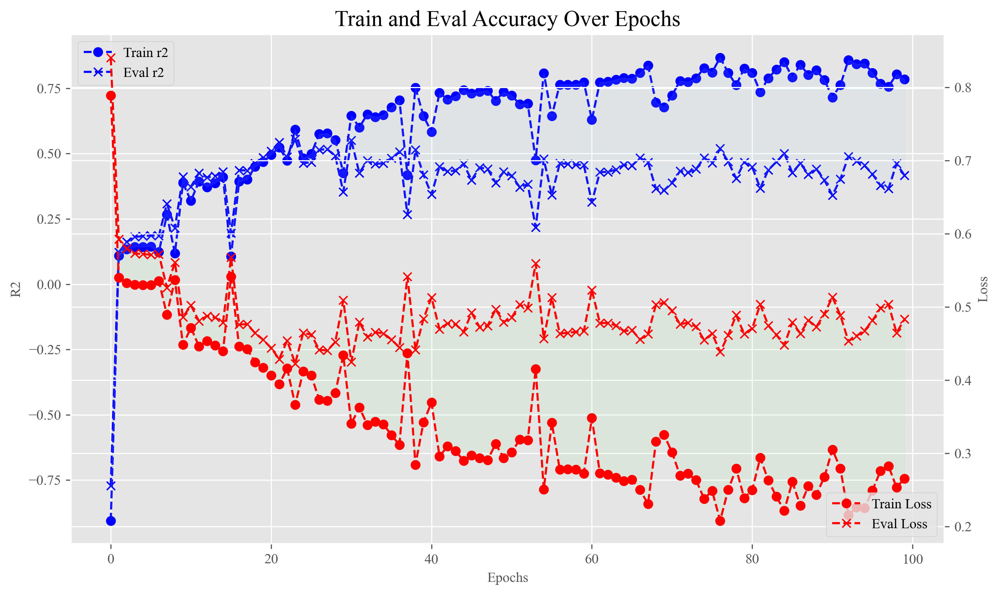

[I 2024-05-06 06:24:05,083] Trial 41 finished with value: 0.4229084849357605 and parameters: {'num_blocks': 7, 'dropout': 0.18037247067827072, 'purns': 0.2287337654745745, 'lr': 9.680504094983747e-05}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.62781822681427 eval_loss:0.6652489304542542 trainr2 -0.20155243129089495 evalr2 -0.11921211955444488
train_loss0.580959677696228 eval_loss:0.6279982328414917 trainr2 -0.029080008976913208 evalr2 0.016428921355945536
train_loss0.5559074878692627 eval_loss:0.5982056856155396 trainr2 0.05739269973829231 evalr2 0.10801314911678173
train_loss0.5468142032623291 eval_loss:0.5863245129585266 trainr2 0.08937593771490282 evalr2 0.1431847578429164
train_loss0.5517219305038452 eval_loss:0.5910307765007019 trainr2 0.07149251831946546 evalr2 0.1294254088620176
train_loss0.551234781742096 eval_loss:0.5895899534225464 trainr2 0.07502596794664096 evalr2 0.1336781152952714
train_loss0.5700469017028809 eval_loss:0.6049769520759583 trainr2 0.006516491162739779 evalr2 0.08766149498992715
train_loss0.5009770393371582 eval_loss:0.5348637700080872 trainr2 0.23160649207198258 evalr2 0.28644578055064396
train_loss0.5682819485664368 eval_loss:0.5956168174743652 trainr2 0.01279185402117955 evalr2 0.11

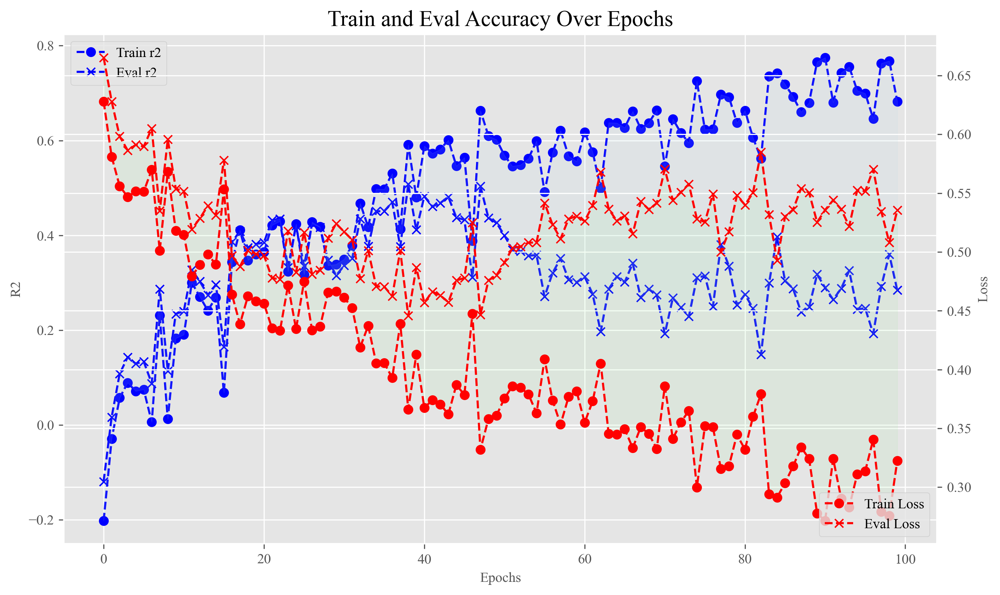

[I 2024-05-06 08:02:19,083] Trial 42 finished with value: 0.44562870264053345 and parameters: {'num_blocks': 7, 'dropout': 0.19498542341801736, 'purns': 0.228396383254709, 'lr': 4.829455487130646e-05}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.7099102735519409 eval_loss:0.7672602534294128 trainr2 -0.5425197284436329 evalr2 -0.4711632469362157
train_loss0.5437568426132202 eval_loss:0.5936020612716675 trainr2 0.09837025480486938 evalr2 0.11826667541096969
train_loss0.5302947163581848 eval_loss:0.5771652460098267 trainr2 0.14277194723742292 evalr2 0.1700703544281077
train_loss0.521565318107605 eval_loss:0.5645787119865417 trainr2 0.17130863725440115 evalr2 0.2063977165518145
train_loss0.5201382040977478 eval_loss:0.5628565549850464 trainr2 0.17471676062316788 evalr2 0.21134533346493378
train_loss0.5202317237854004 eval_loss:0.5617563128471375 trainr2 0.175844441150236 evalr2 0.21456558718937002
train_loss0.516944408416748 eval_loss:0.5538103580474854 trainr2 0.18268976492691302 evalr2 0.2371796507646925
train_loss0.4813993275165558 eval_loss:0.5170255899429321 trainr2 0.29060335023686334 evalr2 0.3350715877419531
train_loss0.5184662342071533 eval_loss:0.5512714385986328 trainr2 0.17870854950799797 evalr2 0.243684030

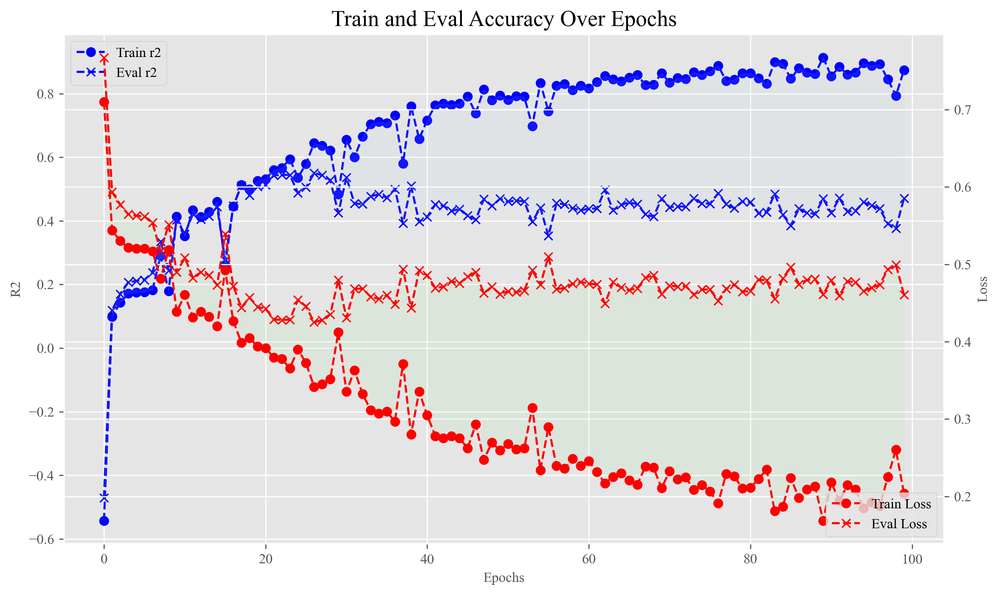

[I 2024-05-06 09:46:17,609] Trial 43 finished with value: 0.42511558532714844 and parameters: {'num_blocks': 7, 'dropout': 0.13041441034705625, 'purns': 0.2315944539217453, 'lr': 8.232317851186651e-05}. Best is trial 20 with value: 0.4131312966346741.


  0%|          | 0/100 [00:00<?, ?it/s]

train_loss0.5963510274887085 eval_loss:0.6409854292869568 trainr2 -0.08492552786715213 evalr2 -0.035787838700239716
train_loss0.536046028137207 eval_loss:0.5823065042495728 trainr2 0.1238641120546432 evalr2 0.15214215305129242
train_loss0.5187289118766785 eval_loss:0.5558241009712219 trainr2 0.17974665903913245 evalr2 0.23028021890060524
train_loss0.5195236206054688 eval_loss:0.5508871078491211 trainr2 0.17785865871328055 evalr2 0.24468551358349133
train_loss0.5135182738304138 eval_loss:0.5455735325813293 trainr2 0.19546828182720455 evalr2 0.25897641992269693
train_loss0.5134149789810181 eval_loss:0.5444731712341309 trainr2 0.19727618793302715 evalr2 0.2620246732485586
train_loss0.5016693472862244 eval_loss:0.5327637791633606 trainr2 0.23017231304120234 evalr2 0.29348537043212963
train_loss0.4798259735107422 eval_loss:0.5134700536727905 trainr2 0.29525744989112424 evalr2 0.3448052237049213
train_loss0.4357658922672272 eval_loss:0.4905349016189575 trainr2 0.42021362172024446 evalr2 0.40

[W 2024-05-06 10:03:57,830] Trial 44 failed with parameters: {'num_blocks': 8, 'dropout': 0.1697529325208786, 'purns': 0.20463288212426767, 'lr': 0.00017771923961940652} because of the following error: KeyboardInterrupt().
Traceback (most recent call last):
  File "F:\code\anaconda\Lib\site-packages\optuna\study\_optimize.py", line 200, in _run_trial
    value_or_values = func(trial)
  File "C:\Users\52551\AppData\Local\Temp\ipykernel_28104\3111886664.py", line 64, in objective
    loss = criterion(logits, labels)
  File "F:\code\anaconda\Lib\site-packages\torch\nn\modules\module.py", line 1507, in _wrapped_call_impl
    def _wrapped_call_impl(self, *args, **kwargs):
KeyboardInterrupt
[W 2024-05-06 10:03:57,833] Trial 44 failed with value None.


KeyboardInterrupt: 